In [3]:
! pip install opencv-python

    100% |████████████████████████████████| 25.0MB 1.5MB/s ta 0:00:011
mxnet-cu80 1.1.0 has requirement numpy<=1.13.3, but you'll have numpy 1.14.5 which is incompatible.
You are using pip version 10.0.1, however version 18.0 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


In [1]:
import numpy as np
import mxnet as mx
from mxnet import gluon, autograd ,nd
from mxnet.gluon import nn, utils
import mxnet.ndarray as F
import cv2

In [2]:
##load fashion-MNIST
def transform(data, label):
    return mx.nd.transpose(data.astype(np.float32), (2,0,1))/127.5 - 1, label.astype(np.float32)

train_data = gluon.data.DataLoader(
    gluon.data.vision.FashionMNIST(train=True, transform=transform), batch_size=32, shuffle=True,last_batch='discard')
    #gluon.data.vision.MNIST(train=True, transform=transform), batch_size=32, shuffle=True,last_batch='discard')

validation_data = gluon.data.DataLoader(
    gluon.data.vision.FashionMNIST(train=False, transform=transform), batch_size=32, shuffle=False,last_batch='discard')
    #gluon.data.vision.MNIST(train=False, transform=transform), batch_size=32, shuffle=False,last_batch='discard')

/opt/venv/lib/python3.6/site-packages/mxnet/gluon/data/vision/datasets.py:118: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  label = np.fromstring(fin.read(), dtype=np.uint8).astype(np.int32)
/opt/venv/lib/python3.6/site-packages/mxnet/gluon/data/vision/datasets.py:122: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fin.read(), dtype=np.uint8)


In [3]:
%pylab inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
#imgplot = plt.imshow(X[0][0] * 255,cmap='gray')
#plt.show()

Populating the interactive namespace from numpy and matplotlib


In [5]:
epochs = 20 
batch_size = 32
latent_z_size = 100

use_gpu = True
ctx = mx.gpu() if use_gpu else mx.cpu()

lr = 0.0002
beta1 = 0.5

In [6]:
# build the generator
nc = 1
ngf = 32
netG = nn.Sequential()
with netG.name_scope():
    # input is Z, going into a convolution
    netG.add(nn.Conv2DTranspose(ngf * 8, 4, 1, 0, use_bias=False))
    netG.add(nn.BatchNorm())
    netG.add(nn.Activation('relu'))
    # state size. (ngf*8) x 4 x 4
    netG.add(nn.Conv2DTranspose(ngf * 4, 4, 2, 1, use_bias=False))
    netG.add(nn.BatchNorm())
    netG.add(nn.Activation('relu'))
    # state size. (ngf*4) x 8 x 8
    netG.add(nn.Conv2DTranspose(ngf * 2, 4, 2, 1, use_bias=False))
    netG.add(nn.BatchNorm())
    netG.add(nn.Activation('relu'))
    # state size. (ngf*2) x 16 x 16
    netG.add(nn.Conv2DTranspose(ngf, 4, 2, 1, use_bias=False))
    netG.add(nn.BatchNorm())
    netG.add(nn.Activation('relu'))
    # state size. () x 32 x 32
    netG.add(nn.Conv2DTranspose(nc, 4, 2, 1, use_bias=False))
    netG.add(nn.Activation('tanh'))
    # state size. (nc) x 64 x 64

In [7]:
netG

Sequential(
  (0): Conv2DTranspose(256 -> 0, kernel_size=(4, 4), stride=(1, 1), bias=False)
  (1): BatchNorm(axis=1, eps=1e-05, momentum=0.9, fix_gamma=False, use_global_stats=False, in_channels=None)
  (2): Activation(relu)
  (3): Conv2DTranspose(128 -> 0, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (4): BatchNorm(axis=1, eps=1e-05, momentum=0.9, fix_gamma=False, use_global_stats=False, in_channels=None)
  (5): Activation(relu)
  (6): Conv2DTranspose(64 -> 0, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (7): BatchNorm(axis=1, eps=1e-05, momentum=0.9, fix_gamma=False, use_global_stats=False, in_channels=None)
  (8): Activation(relu)
  (9): Conv2DTranspose(32 -> 0, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (10): BatchNorm(axis=1, eps=1e-05, momentum=0.9, fix_gamma=False, use_global_stats=False, in_channels=None)
  (11): Activation(relu)
  (12): Conv2DTranspose(1 -> 0, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=

In [8]:
# build the discriminator
ndf = 32
netD = nn.Sequential()
with netD.name_scope():
    # input is (nc) x 64 x 64
    netD.add(nn.Conv2D(ndf, 4, 2, 1, use_bias=False))
    netD.add(nn.LeakyReLU(0.2))
    # state size. (ndf) x 32 x 32
    netD.add(nn.Conv2D(ndf * 2, 4, 2, 1, use_bias=False))
    netD.add(nn.BatchNorm())
    netD.add(nn.LeakyReLU(0.2))
    # state size. (ndf*2) x 16 x 16
    netD.add(nn.Conv2D(ndf * 4, 4, 2, 1, use_bias=False))
    netD.add(nn.BatchNorm())
    netD.add(nn.LeakyReLU(0.2))
    # state size. (ndf*4) x 8 x 8
    netD.add(nn.Conv2D(ndf * 8, 4, 2, 1, use_bias=False))
    netD.add(nn.BatchNorm())
    netD.add(nn.LeakyReLU(0.2))
    # state size. (ndf*8) x 4 x 4
    netD.add(nn.Conv2D(1, 4, 1, 0, use_bias=False))
    # state size. (ndf) x 1 x 1

In [9]:
# loss
loss = gluon.loss.SigmoidBinaryCrossEntropyLoss()
# initialize the generator and the discriminator
netG.initialize(mx.init.Normal(0.02), ctx=ctx)
netD.initialize(mx.init.Normal(0.02), ctx=ctx)

# trainer for the generator and the discriminator
trainerG = gluon.Trainer(netG.collect_params(), 'adam', {'learning_rate': lr, 'beta1': beta1})
trainerD = gluon.Trainer(netD.collect_params(), 'adam', {'learning_rate': lr, 'beta1': beta1})

In [11]:
# test에서 항상 뽑아볼 수 있는 고정된 z를 사전에 뽑아둡니다.
fixed_z = nd.random.uniform(shape = (16, latent_z_size, 1, 1), ctx = ctx)

INFO:root:speed: 128.80038385505634 samples/s
INFO:root:discriminator loss = 1.755800, generator loss = 1.786416, binary training acc = 0.500000 at iter 0 epoch 0
DEBUG:matplotlib.font_manager:findfont: Matching :family=NanumGothicCoding:style=normal:variant=normal:weight=normal:stretch=normal:size=10.0 to NanumGothicCoding ('/usr/share/fonts/truetype/nanum/NanumGothic_Coding.ttf') with score of 0.050000


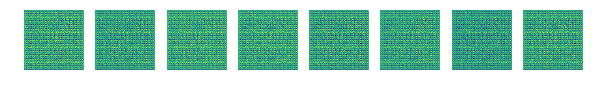

INFO:root:speed: 1135.6002402890238 samples/s
INFO:root:discriminator loss = 0.012569, generator loss = 6.792567, binary training acc = 0.988088 at iter 100 epoch 0


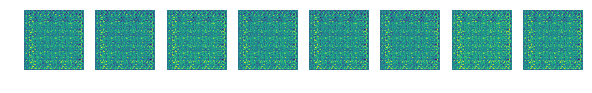

INFO:root:speed: 1294.67563109512 samples/s
INFO:root:discriminator loss = 0.004071, generator loss = 7.275334, binary training acc = 0.993548 at iter 200 epoch 0


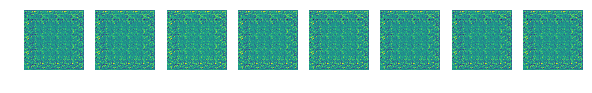

INFO:root:speed: 1179.117166978538 samples/s
INFO:root:discriminator loss = 0.002021, generator loss = 7.585663, binary training acc = 0.995640 at iter 300 epoch 0


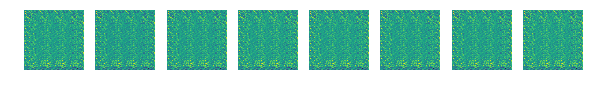

INFO:root:speed: 1149.4491423090428 samples/s
INFO:root:discriminator loss = 0.001047, generator loss = 7.746404, binary training acc = 0.996727 at iter 400 epoch 0


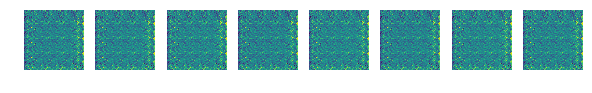

INFO:root:speed: 1258.2282885855707 samples/s
INFO:root:discriminator loss = 0.000690, generator loss = 7.813010, binary training acc = 0.997349 at iter 500 epoch 0


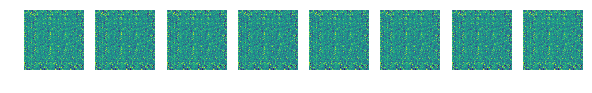

INFO:root:speed: 1274.682824445605 samples/s
INFO:root:discriminator loss = 0.035591, generator loss = 7.279226, binary training acc = 0.992980 at iter 600 epoch 0


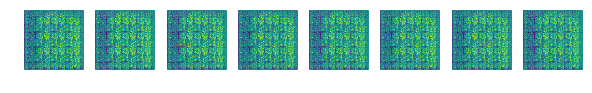

INFO:root:speed: 1286.954080409623 samples/s
INFO:root:discriminator loss = 0.051465, generator loss = 6.277599, binary training acc = 0.990906 at iter 700 epoch 0


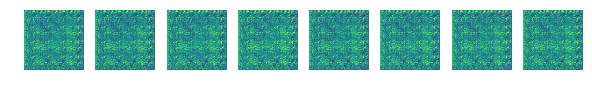

INFO:root:speed: 1234.606054473706 samples/s
INFO:root:discriminator loss = 0.002155, generator loss = 6.957997, binary training acc = 0.991944 at iter 800 epoch 0


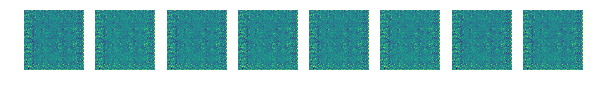

INFO:root:speed: 1284.1712640048988 samples/s
INFO:root:discriminator loss = 0.017054, generator loss = 6.010092, binary training acc = 0.992751 at iter 900 epoch 0


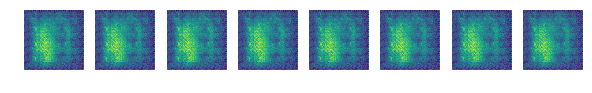

INFO:root:speed: 1278.349299477108 samples/s
INFO:root:discriminator loss = 0.748505, generator loss = 0.988287, binary training acc = 0.986108 at iter 1000 epoch 0


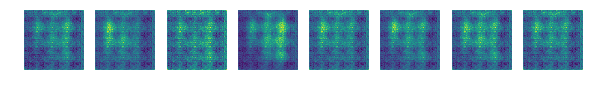

INFO:root:speed: 1116.703646695676 samples/s
INFO:root:discriminator loss = 0.541626, generator loss = 10.362720, binary training acc = 0.982558 at iter 1100 epoch 0


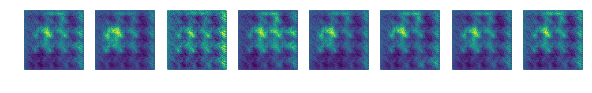

INFO:root:speed: 1238.0110317855629 samples/s
INFO:root:discriminator loss = 0.188380, generator loss = 4.446177, binary training acc = 0.978833 at iter 1200 epoch 0


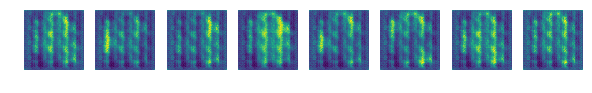

INFO:root:speed: 1247.689736272113 samples/s
INFO:root:discriminator loss = 0.177855, generator loss = 3.941260, binary training acc = 0.977914 at iter 1300 epoch 0


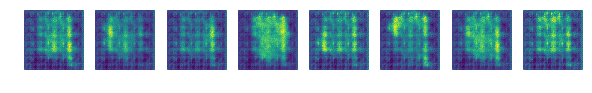

INFO:root:speed: 1274.6707187357545 samples/s
INFO:root:discriminator loss = 0.207067, generator loss = 3.459242, binary training acc = 0.975430 at iter 1400 epoch 0


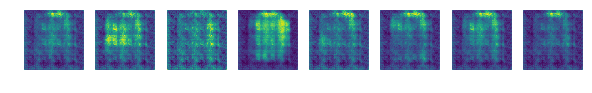

INFO:root:speed: 1286.0908576958825 samples/s
INFO:root:discriminator loss = 0.499809, generator loss = 4.118295, binary training acc = 0.971415 at iter 1500 epoch 0


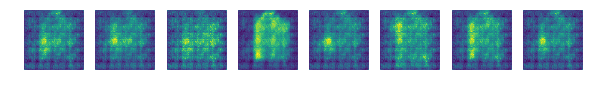

INFO:root:speed: 1266.1810909228127 samples/s
INFO:root:discriminator loss = 0.569182, generator loss = 4.524168, binary training acc = 0.967130 at iter 1600 epoch 0


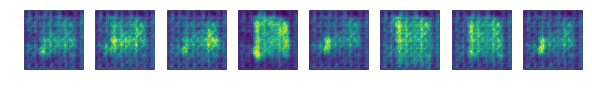

INFO:root:speed: 1197.859203198629 samples/s
INFO:root:discriminator loss = 0.336552, generator loss = 3.993951, binary training acc = 0.962173 at iter 1700 epoch 0


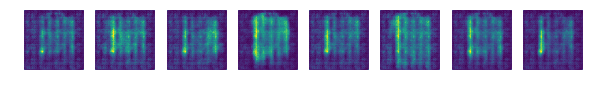

INFO:root:speed: 1271.1456604917225 samples/s
INFO:root:discriminator loss = 0.345989, generator loss = 1.893638, binary training acc = 0.960638 at iter 1800 epoch 0


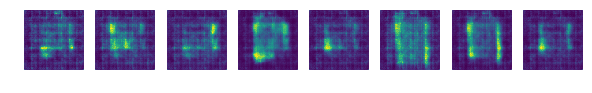

INFO:root:speed: 387.6816924027891 samples/s
INFO:root:discriminator loss = 1.602114, generator loss = 6.052344, binary training acc = 0.609375 at iter 0 epoch 1


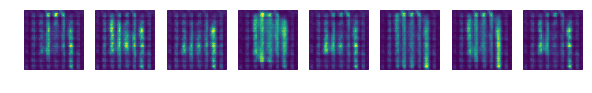

INFO:root:speed: 1245.9523778580246 samples/s
INFO:root:discriminator loss = 0.223857, generator loss = 4.014592, binary training acc = 0.942915 at iter 100 epoch 1


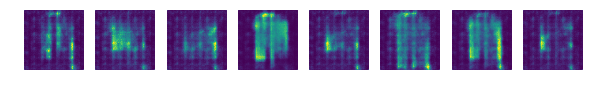

INFO:root:speed: 1195.5970782112952 samples/s
INFO:root:discriminator loss = 0.581508, generator loss = 5.599720, binary training acc = 0.927861 at iter 200 epoch 1


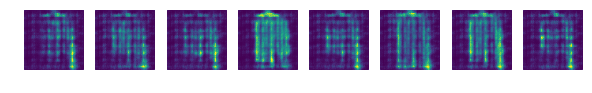

INFO:root:speed: 1152.4792031598831 samples/s
INFO:root:discriminator loss = 0.179526, generator loss = 3.614406, binary training acc = 0.920110 at iter 300 epoch 1


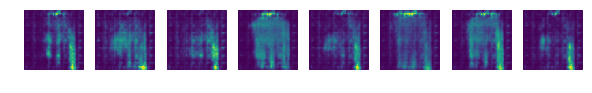

INFO:root:speed: 1198.1800067846239 samples/s
INFO:root:discriminator loss = 0.232394, generator loss = 2.880238, binary training acc = 0.907614 at iter 400 epoch 1


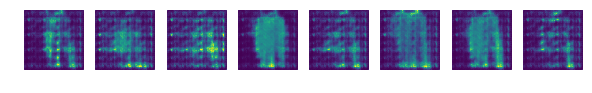

INFO:root:speed: 1232.8143215364973 samples/s
INFO:root:discriminator loss = 0.188360, generator loss = 3.598646, binary training acc = 0.910429 at iter 500 epoch 1


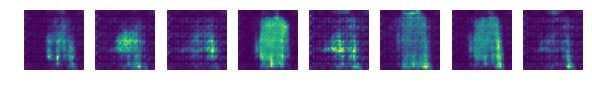

INFO:root:speed: 1229.7081707071263 samples/s
INFO:root:discriminator loss = 0.258159, generator loss = 3.892968, binary training acc = 0.910722 at iter 600 epoch 1


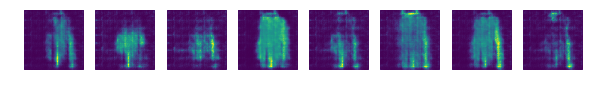

INFO:root:speed: 1255.9676598293158 samples/s
INFO:root:discriminator loss = 0.218470, generator loss = 2.243003, binary training acc = 0.913561 at iter 700 epoch 1


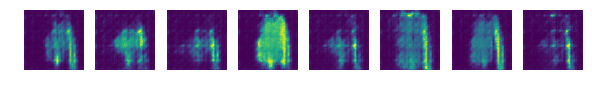

INFO:root:speed: 1111.7641582108097 samples/s
INFO:root:discriminator loss = 0.529159, generator loss = 5.391952, binary training acc = 0.912063 at iter 800 epoch 1


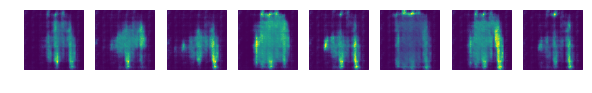

INFO:root:speed: 1201.0427468210576 samples/s
INFO:root:discriminator loss = 0.391288, generator loss = 3.828495, binary training acc = 0.914886 at iter 900 epoch 1


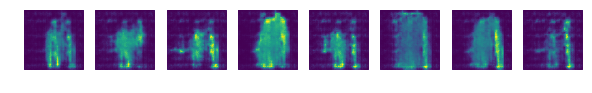

INFO:root:speed: 1118.7607568558806 samples/s
INFO:root:discriminator loss = 0.395907, generator loss = 2.930305, binary training acc = 0.914429 at iter 1000 epoch 1


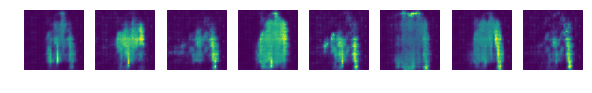

INFO:root:speed: 1202.6139330675148 samples/s
INFO:root:discriminator loss = 0.361104, generator loss = 5.014943, binary training acc = 0.914680 at iter 1100 epoch 1


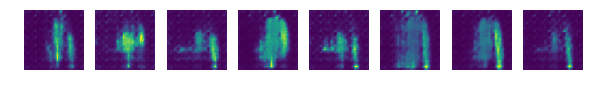

INFO:root:speed: 1222.8848617375063 samples/s
INFO:root:discriminator loss = 0.356583, generator loss = 3.574335, binary training acc = 0.911961 at iter 1200 epoch 1


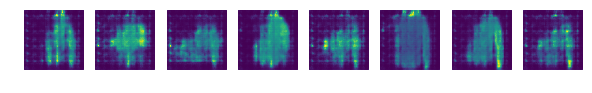

INFO:root:speed: 1243.620365994904 samples/s
INFO:root:discriminator loss = 0.245426, generator loss = 2.276080, binary training acc = 0.914825 at iter 1300 epoch 1


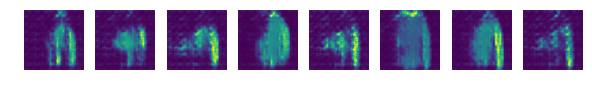

INFO:root:speed: 1286.4483379979297 samples/s
INFO:root:discriminator loss = 0.468608, generator loss = 6.968248, binary training acc = 0.913644 at iter 1400 epoch 1


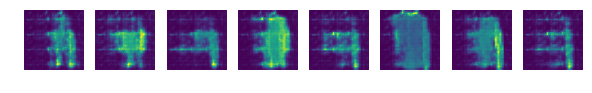

INFO:root:speed: 1208.3087532296834 samples/s
INFO:root:discriminator loss = 1.392975, generator loss = 8.552466, binary training acc = 0.916535 at iter 1500 epoch 1


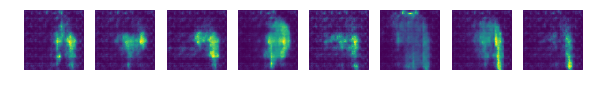

INFO:root:speed: 1226.8643040612803 samples/s
INFO:root:discriminator loss = 0.210082, generator loss = 3.305686, binary training acc = 0.915463 at iter 1600 epoch 1


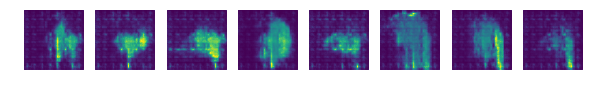

INFO:root:speed: 1081.415548733815 samples/s
INFO:root:discriminator loss = 0.099751, generator loss = 3.628838, binary training acc = 0.918789 at iter 1700 epoch 1


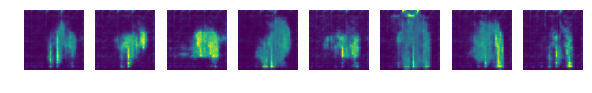

INFO:root:speed: 1208.7766850390865 samples/s
INFO:root:discriminator loss = 0.261783, generator loss = 3.896114, binary training acc = 0.917624 at iter 1800 epoch 1


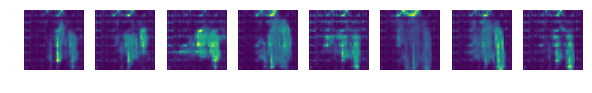

INFO:root:speed: 384.9442105383918 samples/s
INFO:root:discriminator loss = 0.115979, generator loss = 4.638595, binary training acc = 1.000000 at iter 0 epoch 2


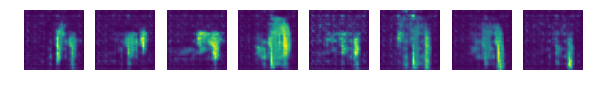

INFO:root:speed: 1276.258527076499 samples/s
INFO:root:discriminator loss = 0.712725, generator loss = 1.016996, binary training acc = 0.910427 at iter 100 epoch 2


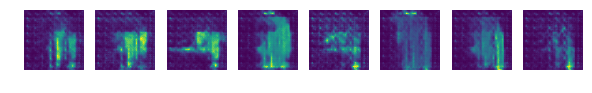

INFO:root:speed: 1200.3016276158112 samples/s
INFO:root:discriminator loss = 0.269280, generator loss = 3.149437, binary training acc = 0.932603 at iter 200 epoch 2


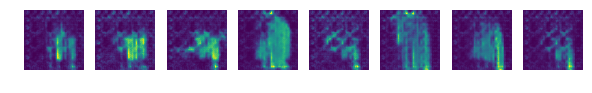

INFO:root:speed: 1260.793086280588 samples/s
INFO:root:discriminator loss = 0.122429, generator loss = 3.617934, binary training acc = 0.933503 at iter 300 epoch 2


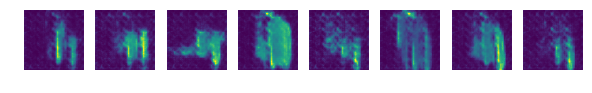

INFO:root:speed: 1248.2699329445793 samples/s
INFO:root:discriminator loss = 0.346470, generator loss = 5.666231, binary training acc = 0.935396 at iter 400 epoch 2


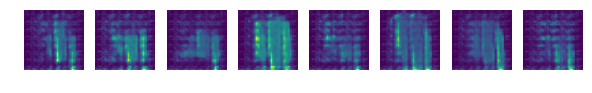

INFO:root:speed: 1200.9675191037777 samples/s
INFO:root:discriminator loss = 0.186709, generator loss = 3.542187, binary training acc = 0.941554 at iter 500 epoch 2


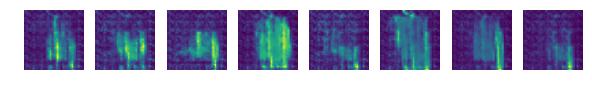

INFO:root:speed: 1216.555734822254 samples/s
INFO:root:discriminator loss = 0.133711, generator loss = 3.599382, binary training acc = 0.940204 at iter 600 epoch 2


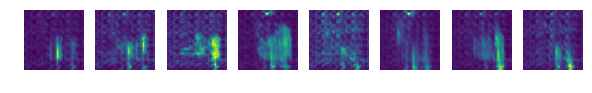

INFO:root:speed: 1281.3882227144275 samples/s
INFO:root:discriminator loss = 0.874651, generator loss = 7.419906, binary training acc = 0.937701 at iter 700 epoch 2


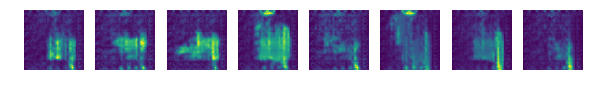

INFO:root:speed: 1104.1819109202495 samples/s
INFO:root:discriminator loss = 0.114938, generator loss = 4.884403, binary training acc = 0.937754 at iter 800 epoch 2


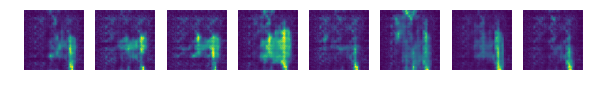

INFO:root:speed: 1258.3816461808192 samples/s
INFO:root:discriminator loss = 0.480845, generator loss = 5.020924, binary training acc = 0.935592 at iter 900 epoch 2


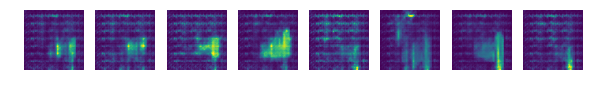

INFO:root:speed: 1097.0250843911172 samples/s
INFO:root:discriminator loss = 0.267448, generator loss = 2.317858, binary training acc = 0.938062 at iter 1000 epoch 2


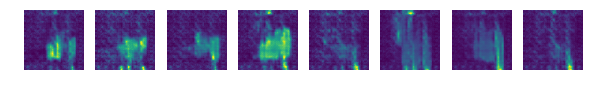

INFO:root:speed: 1207.439145728191 samples/s
INFO:root:discriminator loss = 0.167752, generator loss = 3.199755, binary training acc = 0.938380 at iter 1100 epoch 2


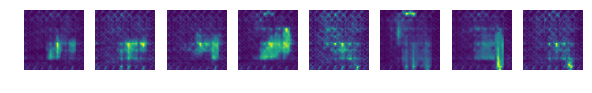

INFO:root:speed: 1264.6778230061811 samples/s
INFO:root:discriminator loss = 0.174228, generator loss = 3.653753, binary training acc = 0.941143 at iter 1200 epoch 2


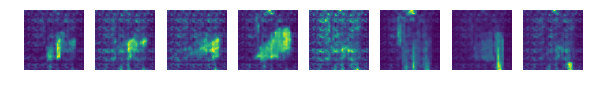

INFO:root:speed: 1235.0604842049083 samples/s
INFO:root:discriminator loss = 0.095139, generator loss = 3.536616, binary training acc = 0.941067 at iter 1300 epoch 2


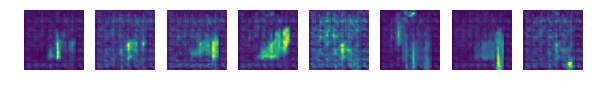

INFO:root:speed: 1257.3324839809645 samples/s
INFO:root:discriminator loss = 0.606406, generator loss = 2.300625, binary training acc = 0.939061 at iter 1400 epoch 2


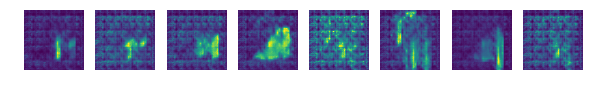

INFO:root:speed: 1253.644878668435 samples/s
INFO:root:discriminator loss = 0.101096, generator loss = 4.193238, binary training acc = 0.940925 at iter 1500 epoch 2


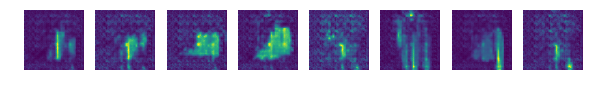

INFO:root:speed: 1194.8520252826493 samples/s
INFO:root:discriminator loss = 0.219235, generator loss = 4.229090, binary training acc = 0.940584 at iter 1600 epoch 2


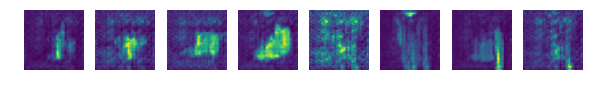

INFO:root:speed: 1193.8529851277308 samples/s
INFO:root:discriminator loss = 0.103066, generator loss = 4.249116, binary training acc = 0.939181 at iter 1700 epoch 2


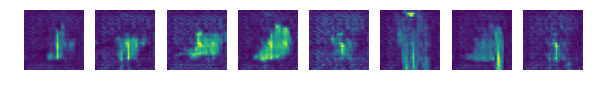

INFO:root:speed: 1113.0364633003558 samples/s
INFO:root:discriminator loss = 0.071752, generator loss = 6.197677, binary training acc = 0.939547 at iter 1800 epoch 2


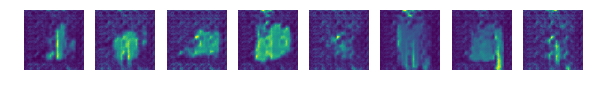

INFO:root:speed: 398.1091659795099 samples/s
INFO:root:discriminator loss = 0.217661, generator loss = 5.594212, binary training acc = 1.000000 at iter 0 epoch 3


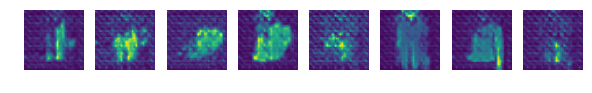

INFO:root:speed: 1187.998796225814 samples/s
INFO:root:discriminator loss = 0.129549, generator loss = 3.761835, binary training acc = 0.957766 at iter 100 epoch 3


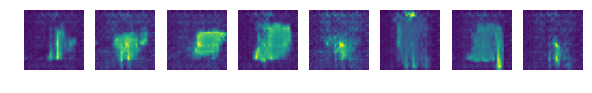

INFO:root:speed: 1187.3892211330904 samples/s
INFO:root:discriminator loss = 0.047034, generator loss = 6.017152, binary training acc = 0.954913 at iter 200 epoch 3


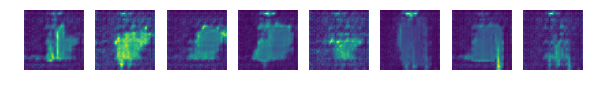

INFO:root:speed: 1278.4832447467186 samples/s
INFO:root:discriminator loss = 0.128355, generator loss = 4.470142, binary training acc = 0.937915 at iter 300 epoch 3


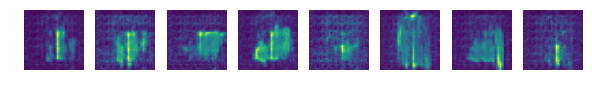

INFO:root:speed: 1249.3737945414603 samples/s
INFO:root:discriminator loss = 0.558307, generator loss = 1.839747, binary training acc = 0.949267 at iter 400 epoch 3


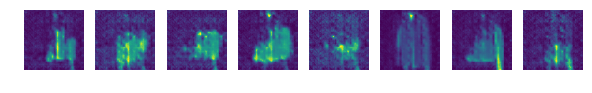

INFO:root:speed: 1242.4231271232725 samples/s
INFO:root:discriminator loss = 0.066554, generator loss = 4.445293, binary training acc = 0.956805 at iter 500 epoch 3


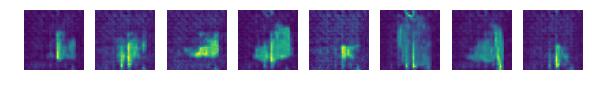

INFO:root:speed: 1196.1191683524787 samples/s
INFO:root:discriminator loss = 0.113366, generator loss = 3.400654, binary training acc = 0.951903 at iter 600 epoch 3


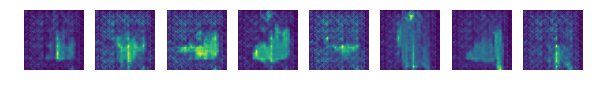

INFO:root:speed: 1273.2559361748552 samples/s
INFO:root:discriminator loss = 0.451561, generator loss = 5.495975, binary training acc = 0.948578 at iter 700 epoch 3


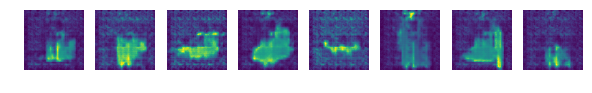

INFO:root:speed: 1104.5817463583244 samples/s
INFO:root:discriminator loss = 0.076117, generator loss = 3.826156, binary training acc = 0.952579 at iter 800 epoch 3


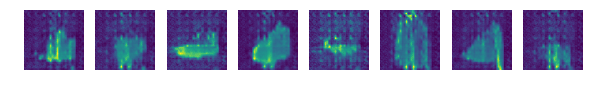

INFO:root:speed: 1177.7720759220422 samples/s
INFO:root:discriminator loss = 0.347241, generator loss = 3.844262, binary training acc = 0.947801 at iter 900 epoch 3


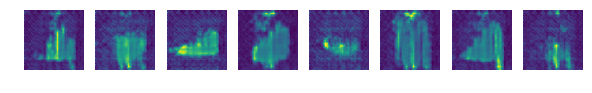

INFO:root:speed: 1098.5694945774503 samples/s
INFO:root:discriminator loss = 0.230952, generator loss = 6.681874, binary training acc = 0.950971 at iter 1000 epoch 3


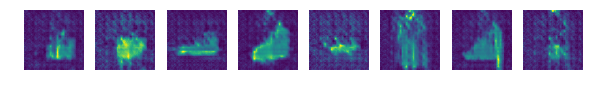

INFO:root:speed: 1231.7056043461903 samples/s
INFO:root:discriminator loss = 0.111915, generator loss = 4.325197, binary training acc = 0.948811 at iter 1100 epoch 3


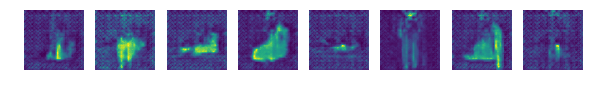

INFO:root:speed: 1115.2190509426594 samples/s
INFO:root:discriminator loss = 0.084487, generator loss = 4.503015, binary training acc = 0.948142 at iter 1200 epoch 3


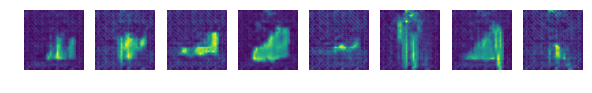

INFO:root:speed: 1188.0829246702665 samples/s
INFO:root:discriminator loss = 0.381420, generator loss = 1.996633, binary training acc = 0.947444 at iter 1300 epoch 3


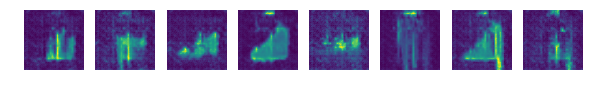

INFO:root:speed: 1104.945484481765 samples/s
INFO:root:discriminator loss = 0.111326, generator loss = 3.474345, binary training acc = 0.948028 at iter 1400 epoch 3


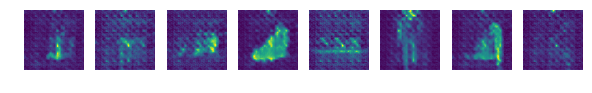

INFO:root:speed: 1193.1313160046936 samples/s
INFO:root:discriminator loss = 0.303221, generator loss = 5.047471, binary training acc = 0.948024 at iter 1500 epoch 3


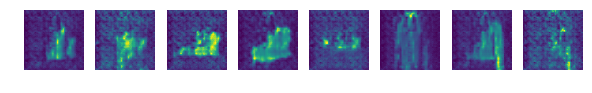

INFO:root:speed: 1285.9060320380163 samples/s
INFO:root:discriminator loss = 0.081947, generator loss = 4.327853, binary training acc = 0.949836 at iter 1600 epoch 3


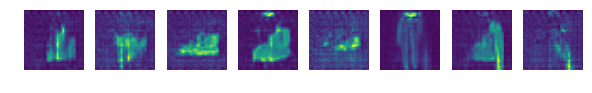

INFO:root:speed: 1239.348532276979 samples/s
INFO:root:discriminator loss = 0.054553, generator loss = 5.134302, binary training acc = 0.951949 at iter 1700 epoch 3


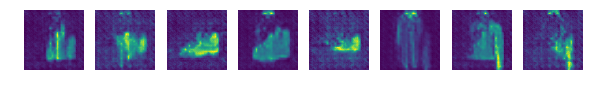

INFO:root:speed: 1243.5627536366164 samples/s
INFO:root:discriminator loss = 0.196142, generator loss = 4.403969, binary training acc = 0.949473 at iter 1800 epoch 3


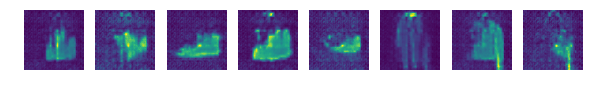

INFO:root:speed: 392.69292075789673 samples/s
INFO:root:discriminator loss = 0.093574, generator loss = 4.817903, binary training acc = 1.000000 at iter 0 epoch 4


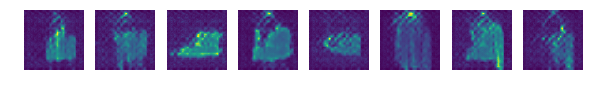

INFO:root:speed: 1284.2572768156158 samples/s
INFO:root:discriminator loss = 0.321549, generator loss = 6.843554, binary training acc = 0.953744 at iter 100 epoch 4


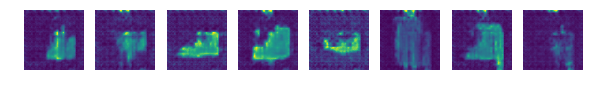

INFO:root:speed: 1239.8522719924622 samples/s
INFO:root:discriminator loss = 0.214331, generator loss = 3.814982, binary training acc = 0.918766 at iter 200 epoch 4


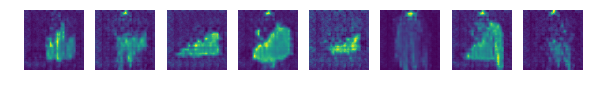

INFO:root:speed: 1113.2303302755338 samples/s
INFO:root:discriminator loss = 0.081059, generator loss = 4.534020, binary training acc = 0.920733 at iter 300 epoch 4


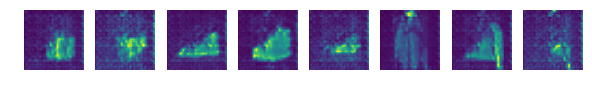

INFO:root:speed: 1274.2108720830881 samples/s
INFO:root:discriminator loss = 0.866150, generator loss = 11.035702, binary training acc = 0.937266 at iter 400 epoch 4


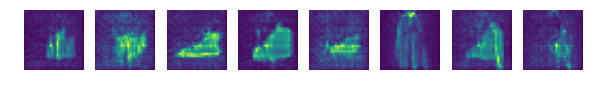

INFO:root:speed: 1105.6918970573697 samples/s
INFO:root:discriminator loss = 0.106492, generator loss = 3.928025, binary training acc = 0.944330 at iter 500 epoch 4


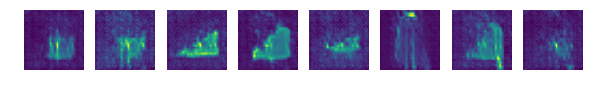

INFO:root:speed: 1225.0055035823484 samples/s
INFO:root:discriminator loss = 0.028578, generator loss = 6.758435, binary training acc = 0.943714 at iter 600 epoch 4


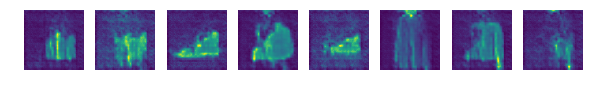

INFO:root:speed: 1106.877302940837 samples/s
INFO:root:discriminator loss = 0.129600, generator loss = 4.707797, binary training acc = 0.945190 at iter 700 epoch 4


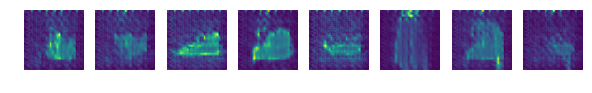

INFO:root:speed: 1250.2699369358459 samples/s
INFO:root:discriminator loss = 0.059250, generator loss = 4.659961, binary training acc = 0.947780 at iter 800 epoch 4


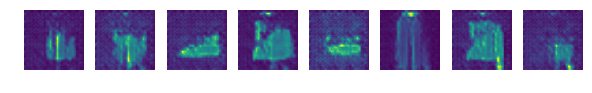

INFO:root:speed: 1192.5694433337776 samples/s
INFO:root:discriminator loss = 0.608242, generator loss = 12.762239, binary training acc = 0.952882 at iter 900 epoch 4


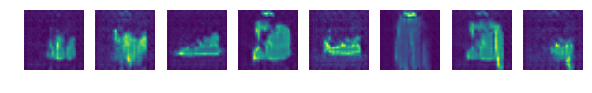

INFO:root:speed: 1267.9633831823378 samples/s
INFO:root:discriminator loss = 1.112800, generator loss = 9.834890, binary training acc = 0.946179 at iter 1000 epoch 4


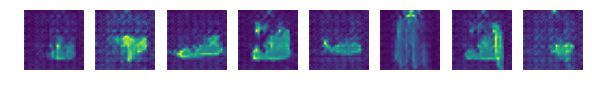

INFO:root:speed: 1267.2211490346033 samples/s
INFO:root:discriminator loss = 1.146677, generator loss = 4.497827, binary training acc = 0.944142 at iter 1100 epoch 4


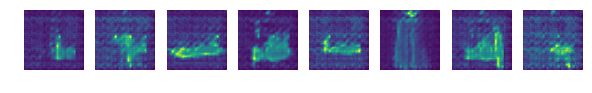

INFO:root:speed: 1235.9020617132755 samples/s
INFO:root:discriminator loss = 0.211949, generator loss = 2.967726, binary training acc = 0.946724 at iter 1200 epoch 4


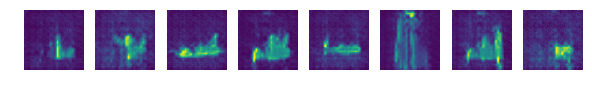

INFO:root:speed: 1272.1094893278234 samples/s
INFO:root:discriminator loss = 0.171000, generator loss = 5.776900, binary training acc = 0.950074 at iter 1300 epoch 4


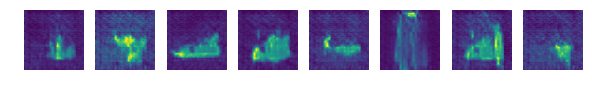

INFO:root:speed: 1260.7575569708242 samples/s
INFO:root:discriminator loss = 1.163769, generator loss = 3.190233, binary training acc = 0.948943 at iter 1400 epoch 4


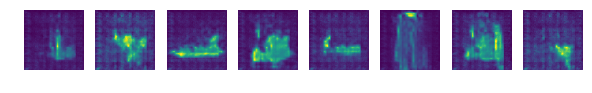

INFO:root:speed: 1108.6968172543966 samples/s
INFO:root:discriminator loss = 0.428337, generator loss = 4.424852, binary training acc = 0.948951 at iter 1500 epoch 4


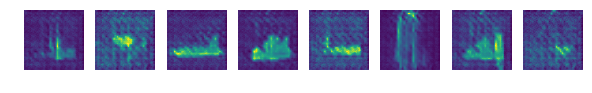

INFO:root:speed: 1262.0141417180682 samples/s
INFO:root:discriminator loss = 0.068191, generator loss = 4.166436, binary training acc = 0.951749 at iter 1600 epoch 4


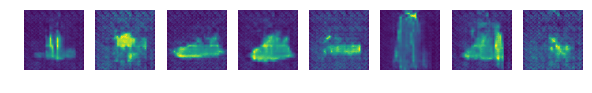

INFO:root:speed: 1105.7738818082205 samples/s
INFO:root:discriminator loss = 0.049105, generator loss = 4.313162, binary training acc = 0.952124 at iter 1700 epoch 4


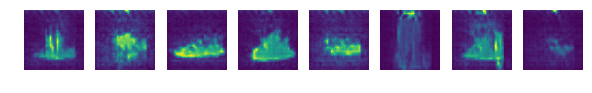

INFO:root:speed: 1257.2735941847068 samples/s
INFO:root:discriminator loss = 0.066662, generator loss = 3.484032, binary training acc = 0.953906 at iter 1800 epoch 4


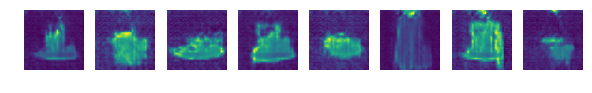

INFO:root:speed: 382.71816045806054 samples/s
INFO:root:discriminator loss = 0.698730, generator loss = 4.754648, binary training acc = 0.843750 at iter 0 epoch 5


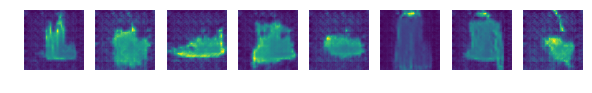

INFO:root:speed: 1143.2515161839863 samples/s
INFO:root:discriminator loss = 0.143187, generator loss = 4.068547, binary training acc = 0.927754 at iter 100 epoch 5


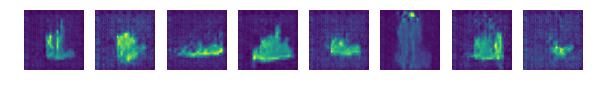

INFO:root:speed: 1180.1539449041143 samples/s
INFO:root:discriminator loss = 0.069149, generator loss = 4.573550, binary training acc = 0.939832 at iter 200 epoch 5


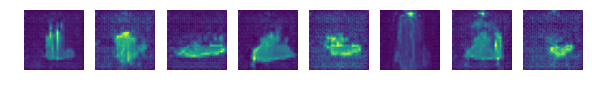

INFO:root:speed: 1193.9910506978854 samples/s
INFO:root:discriminator loss = 0.239595, generator loss = 4.757277, binary training acc = 0.947259 at iter 300 epoch 5


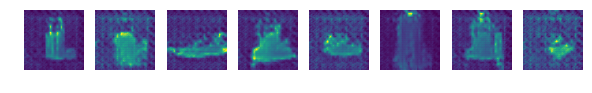

INFO:root:speed: 1191.9763412403088 samples/s
INFO:root:discriminator loss = 0.183968, generator loss = 3.362021, binary training acc = 0.945877 at iter 400 epoch 5


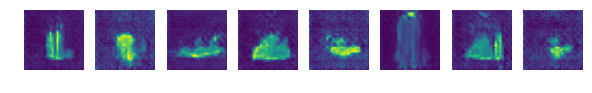

INFO:root:speed: 1176.0589529025192 samples/s
INFO:root:discriminator loss = 0.063370, generator loss = 4.261178, binary training acc = 0.955464 at iter 500 epoch 5


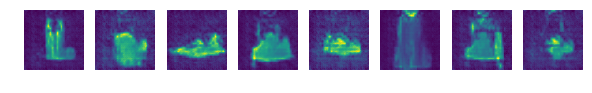

INFO:root:speed: 1265.954178889088 samples/s
INFO:root:discriminator loss = 2.639545, generator loss = 0.598936, binary training acc = 0.949381 at iter 600 epoch 5


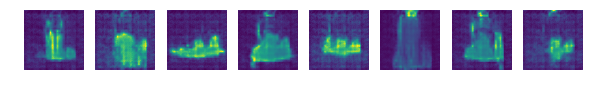

INFO:root:speed: 1221.382546182546 samples/s
INFO:root:discriminator loss = 0.049619, generator loss = 5.335984, binary training acc = 0.950428 at iter 700 epoch 5


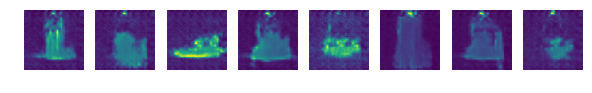

INFO:root:speed: 1231.9769424939188 samples/s
INFO:root:discriminator loss = 1.249828, generator loss = 2.995198, binary training acc = 0.944171 at iter 800 epoch 5


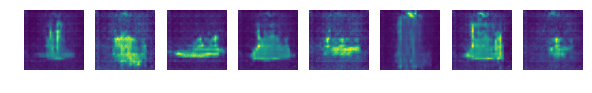

INFO:root:speed: 1250.6893537716069 samples/s
INFO:root:discriminator loss = 0.173758, generator loss = 4.371659, binary training acc = 0.937136 at iter 900 epoch 5


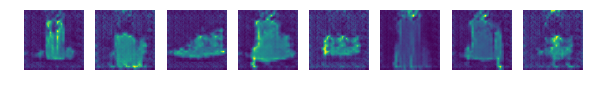

INFO:root:speed: 1251.7858255379076 samples/s
INFO:root:discriminator loss = 0.062316, generator loss = 4.992783, binary training acc = 0.940747 at iter 1000 epoch 5


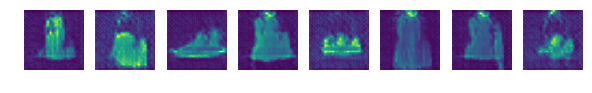

INFO:root:speed: 1249.699515828678 samples/s
INFO:root:discriminator loss = 0.024751, generator loss = 5.268075, binary training acc = 0.945916 at iter 1100 epoch 5


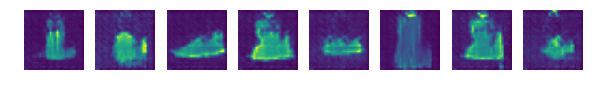

INFO:root:speed: 1266.252764255255 samples/s
INFO:root:discriminator loss = 0.067095, generator loss = 5.282616, binary training acc = 0.946269 at iter 1200 epoch 5


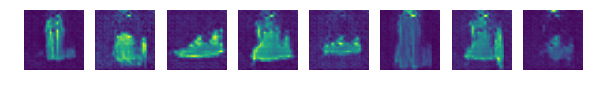

INFO:root:speed: 1269.5705407731818 samples/s
INFO:root:discriminator loss = 0.280178, generator loss = 1.669150, binary training acc = 0.944766 at iter 1300 epoch 5


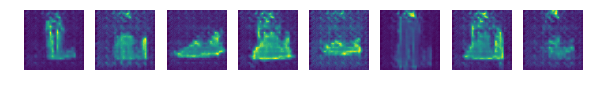

INFO:root:speed: 1112.280105080841 samples/s
INFO:root:discriminator loss = 0.112965, generator loss = 3.350177, binary training acc = 0.944192 at iter 1400 epoch 5


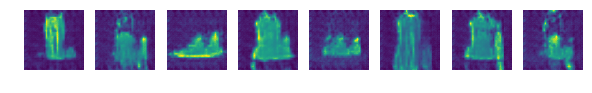

INFO:root:speed: 1267.8196571104709 samples/s
INFO:root:discriminator loss = 0.085318, generator loss = 4.143587, binary training acc = 0.943423 at iter 1500 epoch 5


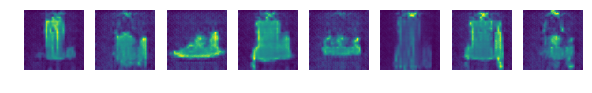

INFO:root:speed: 1264.1537128433108 samples/s
INFO:root:discriminator loss = 0.025563, generator loss = 4.929824, binary training acc = 0.945981 at iter 1600 epoch 5


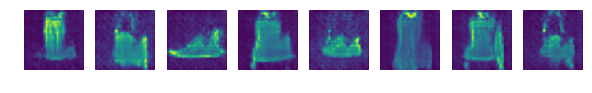

INFO:root:speed: 1198.0195835155714 samples/s
INFO:root:discriminator loss = 0.350265, generator loss = 6.715482, binary training acc = 0.944408 at iter 1700 epoch 5


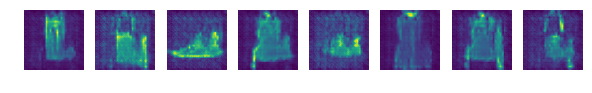

INFO:root:speed: 1103.9094617712858 samples/s
INFO:root:discriminator loss = 0.055588, generator loss = 4.434442, binary training acc = 0.946349 at iter 1800 epoch 5


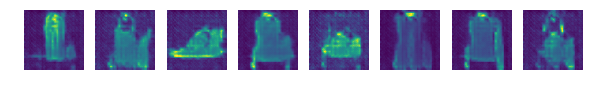

INFO:root:speed: 386.6241340273597 samples/s
INFO:root:discriminator loss = 0.057870, generator loss = 4.999387, binary training acc = 1.000000 at iter 0 epoch 6


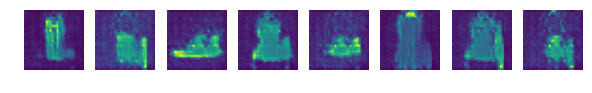

INFO:root:speed: 1214.079727908386 samples/s
INFO:root:discriminator loss = 0.095103, generator loss = 5.066601, binary training acc = 0.994585 at iter 100 epoch 6


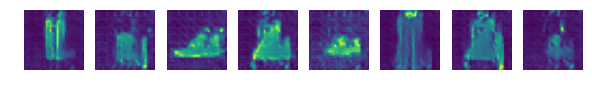

INFO:root:speed: 1108.4862159528254 samples/s
INFO:root:discriminator loss = 0.109738, generator loss = 4.095184, binary training acc = 0.979633 at iter 200 epoch 6


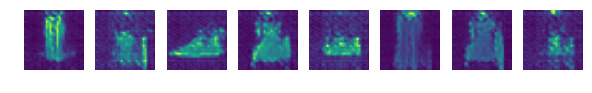

INFO:root:speed: 1274.27135926478 samples/s
INFO:root:discriminator loss = 0.024929, generator loss = 6.359832, binary training acc = 0.966933 at iter 300 epoch 6


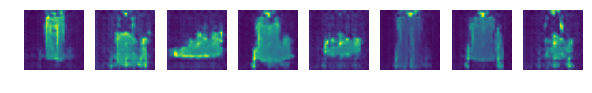

INFO:root:speed: 1268.8024351738936 samples/s
INFO:root:discriminator loss = 0.074920, generator loss = 5.297738, binary training acc = 0.966295 at iter 400 epoch 6


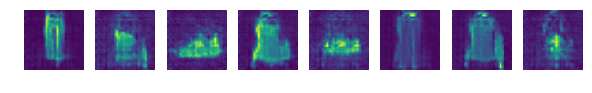

INFO:root:speed: 1190.6440160742325 samples/s
INFO:root:discriminator loss = 0.643251, generator loss = 3.440894, binary training acc = 0.967191 at iter 500 epoch 6


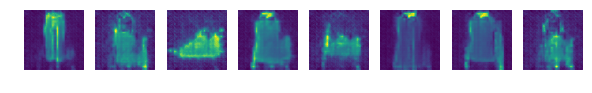

INFO:root:speed: 1200.5807825106892 samples/s
INFO:root:discriminator loss = 0.298014, generator loss = 2.767855, binary training acc = 0.962874 at iter 600 epoch 6


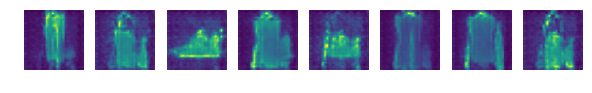

INFO:root:speed: 1266.58734712366 samples/s
INFO:root:discriminator loss = 0.031024, generator loss = 4.821375, binary training acc = 0.964047 at iter 700 epoch 6


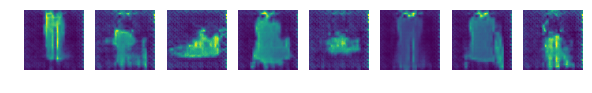

INFO:root:speed: 1262.227772866628 samples/s
INFO:root:discriminator loss = 1.132472, generator loss = 3.123310, binary training acc = 0.963249 at iter 800 epoch 6


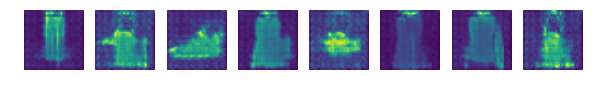

INFO:root:speed: 1264.7374084788405 samples/s
INFO:root:discriminator loss = 0.949908, generator loss = 1.992375, binary training acc = 0.960599 at iter 900 epoch 6


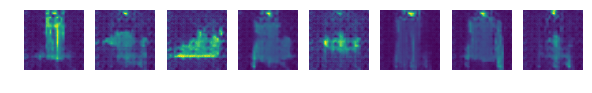

INFO:root:speed: 1263.4991857060822 samples/s
INFO:root:discriminator loss = 0.035311, generator loss = 7.353868, binary training acc = 0.958947 at iter 1000 epoch 6


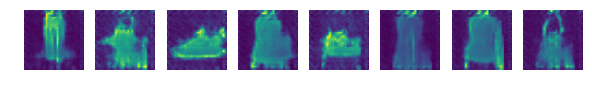

INFO:root:speed: 1215.9936218596265 samples/s
INFO:root:discriminator loss = 0.128373, generator loss = 6.659359, binary training acc = 0.962577 at iter 1100 epoch 6


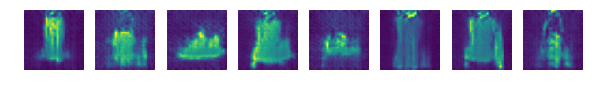

INFO:root:speed: 1253.0128832293963 samples/s
INFO:root:discriminator loss = 0.178440, generator loss = 3.835102, binary training acc = 0.957887 at iter 1200 epoch 6


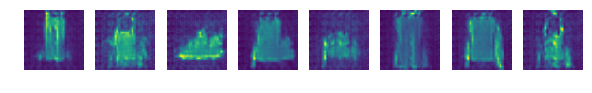

INFO:root:speed: 1275.4338277916622 samples/s
INFO:root:discriminator loss = 0.047799, generator loss = 4.511091, binary training acc = 0.956572 at iter 1300 epoch 6


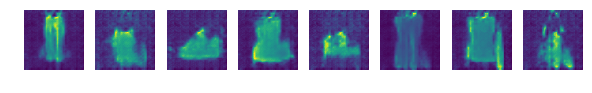

INFO:root:speed: 1242.7107144179845 samples/s
INFO:root:discriminator loss = 0.123713, generator loss = 5.259664, binary training acc = 0.959437 at iter 1400 epoch 6


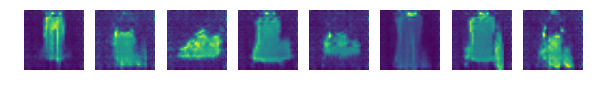

INFO:root:speed: 1106.5396595078116 samples/s
INFO:root:discriminator loss = 0.192110, generator loss = 3.303795, binary training acc = 0.958986 at iter 1500 epoch 6


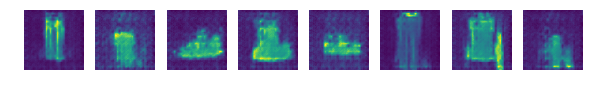

INFO:root:speed: 1202.7324766564511 samples/s
INFO:root:discriminator loss = 0.103517, generator loss = 6.045628, binary training acc = 0.961264 at iter 1600 epoch 6


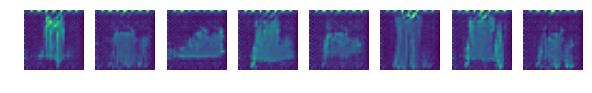

INFO:root:speed: 1112.934940877958 samples/s
INFO:root:discriminator loss = 0.021231, generator loss = 5.464216, binary training acc = 0.963450 at iter 1700 epoch 6


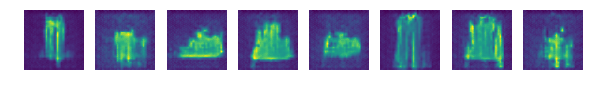

INFO:root:speed: 1265.083114973514 samples/s
INFO:root:discriminator loss = 0.981873, generator loss = 0.267044, binary training acc = 0.964447 at iter 1800 epoch 6


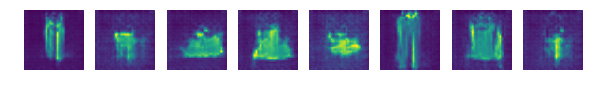

INFO:root:speed: 399.2175180397499 samples/s
INFO:root:discriminator loss = 0.075739, generator loss = 3.610593, binary training acc = 0.984375 at iter 0 epoch 7


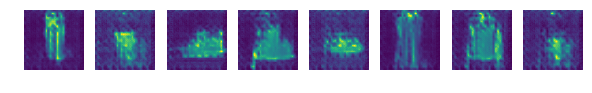

INFO:root:speed: 1117.9872889473816 samples/s
INFO:root:discriminator loss = 0.108235, generator loss = 3.674559, binary training acc = 0.955446 at iter 100 epoch 7


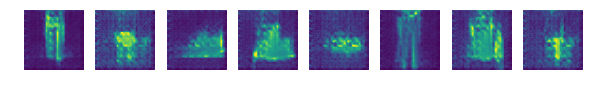

INFO:root:speed: 1175.8322864376637 samples/s
INFO:root:discriminator loss = 1.352069, generator loss = 0.104153, binary training acc = 0.940687 at iter 200 epoch 7


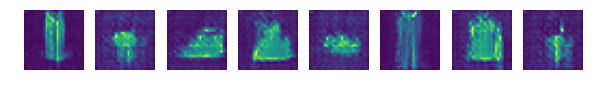

INFO:root:speed: 1239.4973218573382 samples/s
INFO:root:discriminator loss = 0.016915, generator loss = 6.564925, binary training acc = 0.950945 at iter 300 epoch 7


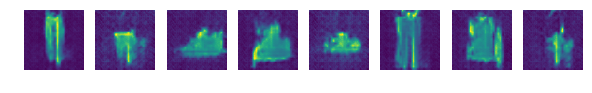

INFO:root:speed: 1200.78486244688 samples/s
INFO:root:discriminator loss = 0.022185, generator loss = 5.903301, binary training acc = 0.955502 at iter 400 epoch 7


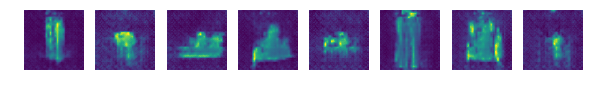

INFO:root:speed: 1149.3015019437928 samples/s
INFO:root:discriminator loss = 0.014017, generator loss = 6.103653, binary training acc = 0.964165 at iter 500 epoch 7


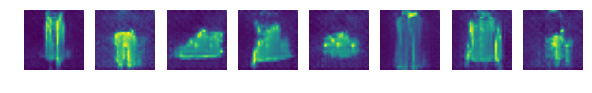

INFO:root:speed: 1251.2140206954414 samples/s
INFO:root:discriminator loss = 0.376596, generator loss = 3.878507, binary training acc = 0.960301 at iter 600 epoch 7


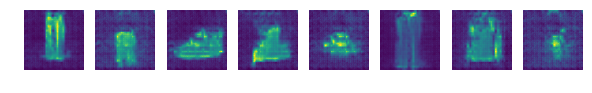

INFO:root:speed: 1197.4424152667125 samples/s
INFO:root:discriminator loss = 0.059989, generator loss = 4.325611, binary training acc = 0.955956 at iter 700 epoch 7


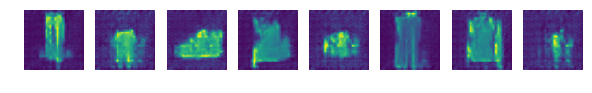

INFO:root:speed: 1107.8731809589844 samples/s
INFO:root:discriminator loss = 1.479615, generator loss = 9.314916, binary training acc = 0.952228 at iter 800 epoch 7


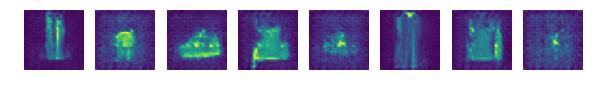

INFO:root:speed: 1242.7567407407407 samples/s
INFO:root:discriminator loss = 0.015402, generator loss = 6.086155, binary training acc = 0.956385 at iter 900 epoch 7


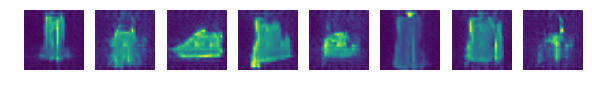

INFO:root:speed: 1271.3503518958805 samples/s
INFO:root:discriminator loss = 0.373725, generator loss = 9.538204, binary training acc = 0.954858 at iter 1000 epoch 7


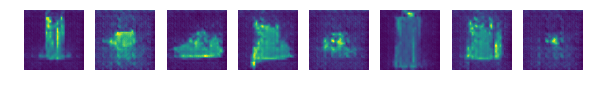

INFO:root:speed: 1193.3116514781063 samples/s
INFO:root:discriminator loss = 0.455264, generator loss = 10.372040, binary training acc = 0.951465 at iter 1100 epoch 7


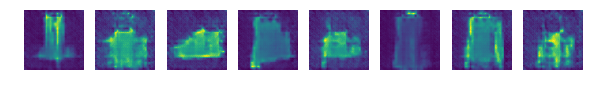

INFO:root:speed: 1255.2511386485855 samples/s
INFO:root:discriminator loss = 0.022591, generator loss = 5.712175, binary training acc = 0.954998 at iter 1200 epoch 7


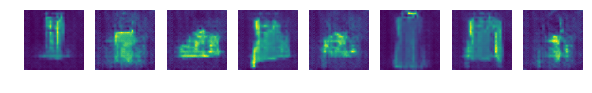

INFO:root:speed: 1271.928660102537 samples/s
INFO:root:discriminator loss = 0.117568, generator loss = 3.283779, binary training acc = 0.956284 at iter 1300 epoch 7


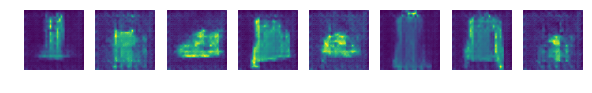

INFO:root:speed: 1258.3108611072048 samples/s
INFO:root:discriminator loss = 0.026033, generator loss = 5.028577, binary training acc = 0.959192 at iter 1400 epoch 7


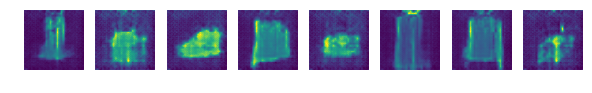

INFO:root:speed: 1274.3681507011897 samples/s
INFO:root:discriminator loss = 0.008255, generator loss = 4.739569, binary training acc = 0.961786 at iter 1500 epoch 7


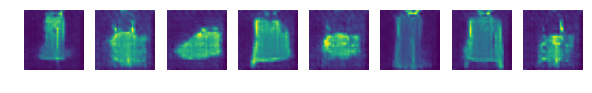

INFO:root:speed: 1105.3731830048673 samples/s
INFO:root:discriminator loss = 0.634663, generator loss = 2.997871, binary training acc = 0.956297 at iter 1600 epoch 7


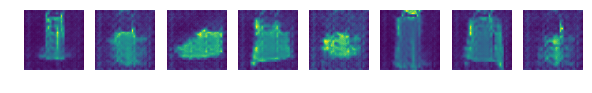

INFO:root:speed: 1236.152481648968 samples/s
INFO:root:discriminator loss = 1.798324, generator loss = 7.178673, binary training acc = 0.954659 at iter 1700 epoch 7


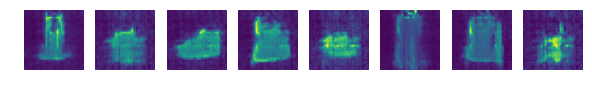

INFO:root:speed: 1188.5247945593653 samples/s
INFO:root:discriminator loss = 0.042154, generator loss = 4.799987, binary training acc = 0.955650 at iter 1800 epoch 7


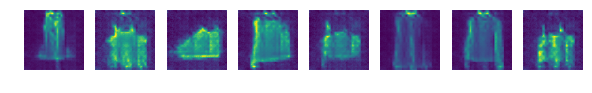

INFO:root:speed: 385.2182079099937 samples/s
INFO:root:discriminator loss = 0.120719, generator loss = 4.669195, binary training acc = 0.984375 at iter 0 epoch 8


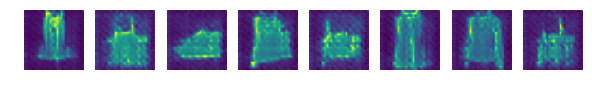

INFO:root:speed: 1245.189472024047 samples/s
INFO:root:discriminator loss = 0.046105, generator loss = 5.477006, binary training acc = 0.995514 at iter 100 epoch 8


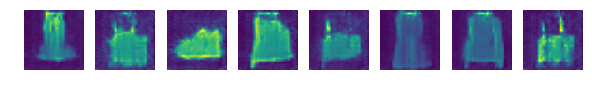

INFO:root:speed: 1144.8605621188212 samples/s
INFO:root:discriminator loss = 0.012957, generator loss = 5.788258, binary training acc = 0.976990 at iter 200 epoch 8


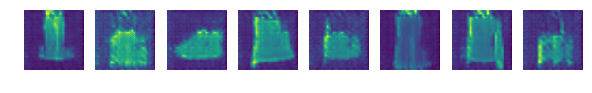

INFO:root:speed: 1270.7124138453382 samples/s
INFO:root:discriminator loss = 0.033106, generator loss = 5.785704, binary training acc = 0.962261 at iter 300 epoch 8


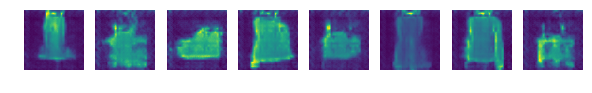

INFO:root:speed: 1118.3599110096407 samples/s
INFO:root:discriminator loss = 0.037447, generator loss = 5.917233, binary training acc = 0.966919 at iter 400 epoch 8


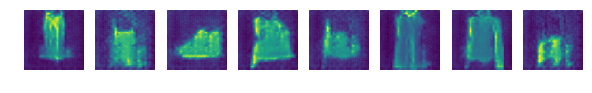

INFO:root:speed: 1218.5991411009525 samples/s
INFO:root:discriminator loss = 0.071451, generator loss = 4.184797, binary training acc = 0.966972 at iter 500 epoch 8


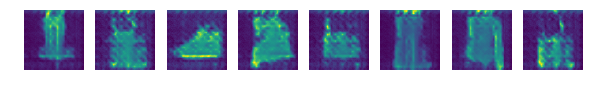

INFO:root:speed: 1250.9924409771738 samples/s
INFO:root:discriminator loss = 0.564154, generator loss = 3.379942, binary training acc = 0.964980 at iter 600 epoch 8


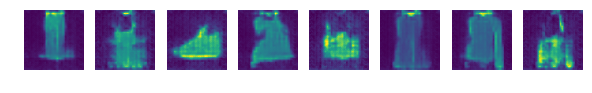

INFO:root:speed: 1238.970996030647 samples/s
INFO:root:discriminator loss = 0.018414, generator loss = 5.277610, binary training acc = 0.966053 at iter 700 epoch 8


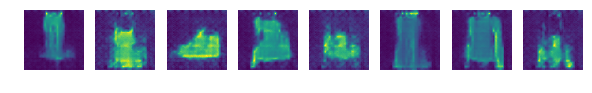

INFO:root:speed: 1174.2172452407615 samples/s
INFO:root:discriminator loss = 0.069151, generator loss = 5.438920, binary training acc = 0.970135 at iter 800 epoch 8


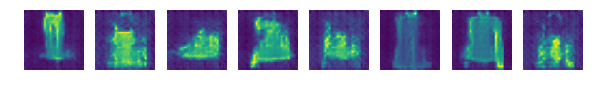

INFO:root:speed: 1232.735061261228 samples/s
INFO:root:discriminator loss = 0.153702, generator loss = 6.231048, binary training acc = 0.963027 at iter 900 epoch 8


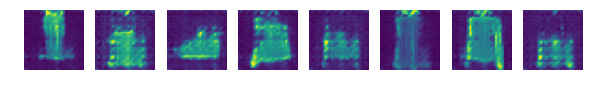

INFO:root:speed: 1232.4407551605084 samples/s
INFO:root:discriminator loss = 0.051760, generator loss = 5.762579, binary training acc = 0.961179 at iter 1000 epoch 8


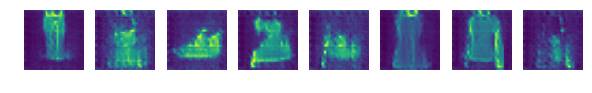

INFO:root:speed: 1198.875671040526 samples/s
INFO:root:discriminator loss = 0.008174, generator loss = 7.946914, binary training acc = 0.963868 at iter 1100 epoch 8


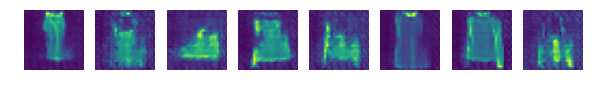

INFO:root:speed: 1221.4381216726579 samples/s
INFO:root:discriminator loss = 0.293176, generator loss = 8.944139, binary training acc = 0.964704 at iter 1200 epoch 8


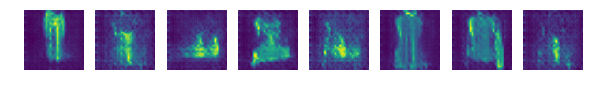

INFO:root:speed: 1286.6086523068664 samples/s
INFO:root:discriminator loss = 0.131456, generator loss = 3.580804, binary training acc = 0.964138 at iter 1300 epoch 8


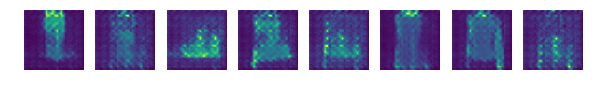

INFO:root:speed: 1240.4252007800153 samples/s
INFO:root:discriminator loss = 0.107095, generator loss = 4.298728, binary training acc = 0.963854 at iter 1400 epoch 8


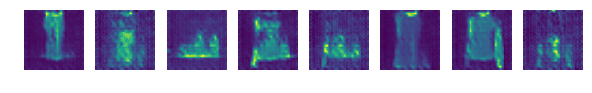

INFO:root:speed: 1263.8680176277826 samples/s
INFO:root:discriminator loss = 0.307999, generator loss = 5.479486, binary training acc = 0.964451 at iter 1500 epoch 8


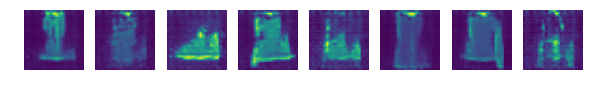

INFO:root:speed: 1265.4886667923818 samples/s
INFO:root:discriminator loss = 0.012709, generator loss = 5.766651, binary training acc = 0.966457 at iter 1600 epoch 8


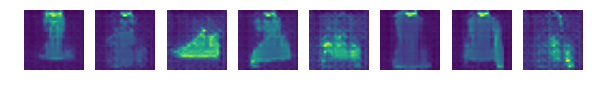

INFO:root:speed: 1233.7322180347458 samples/s
INFO:root:discriminator loss = 0.360388, generator loss = 2.087421, binary training acc = 0.964699 at iter 1700 epoch 8


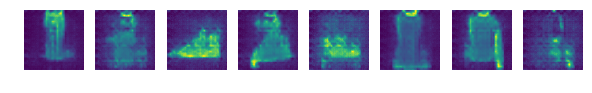

INFO:root:speed: 1188.0724079631057 samples/s
INFO:root:discriminator loss = 0.067629, generator loss = 5.186226, binary training acc = 0.964525 at iter 1800 epoch 8


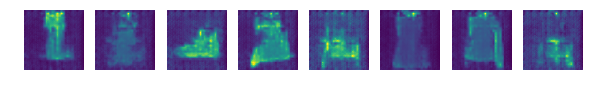

INFO:root:speed: 399.11186442693975 samples/s
INFO:root:discriminator loss = 0.050010, generator loss = 4.477649, binary training acc = 1.000000 at iter 0 epoch 9


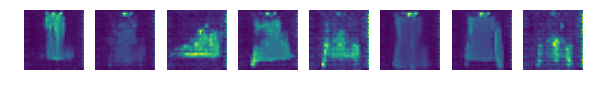

INFO:root:speed: 1245.2472352111631 samples/s
INFO:root:discriminator loss = 0.042613, generator loss = 4.941089, binary training acc = 0.975866 at iter 100 epoch 9


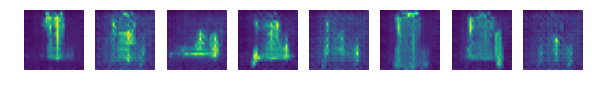

INFO:root:speed: 1245.2703419866025 samples/s
INFO:root:discriminator loss = 0.029408, generator loss = 6.233378, binary training acc = 0.986474 at iter 200 epoch 9


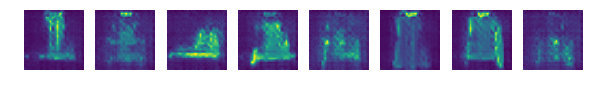

INFO:root:speed: 1115.2931869738995 samples/s
INFO:root:discriminator loss = 0.017048, generator loss = 5.933023, binary training acc = 0.990760 at iter 300 epoch 9


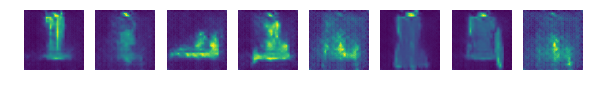

INFO:root:speed: 1268.1191232048375 samples/s
INFO:root:discriminator loss = 2.812569, generator loss = 1.626350, binary training acc = 0.969023 at iter 400 epoch 9


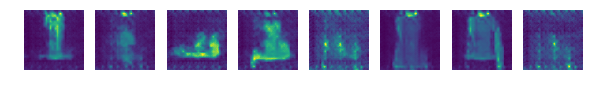

INFO:root:speed: 1267.1254401782428 samples/s
INFO:root:discriminator loss = 0.581513, generator loss = 2.786837, binary training acc = 0.962980 at iter 500 epoch 9


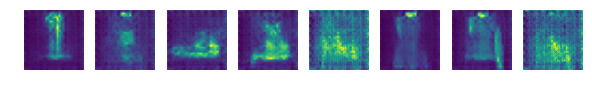

INFO:root:speed: 1202.6570371233233 samples/s
INFO:root:discriminator loss = 0.026845, generator loss = 5.217413, binary training acc = 0.959807 at iter 600 epoch 9


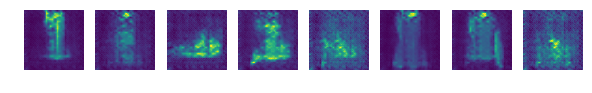

INFO:root:speed: 1275.8824289896954 samples/s
INFO:root:discriminator loss = 0.008947, generator loss = 6.071482, binary training acc = 0.962598 at iter 700 epoch 9


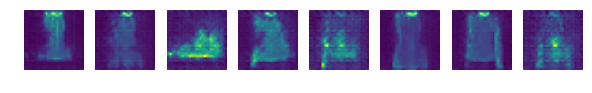

INFO:root:speed: 1243.781709000936 samples/s
INFO:root:discriminator loss = 0.011769, generator loss = 5.587870, binary training acc = 0.967092 at iter 800 epoch 9


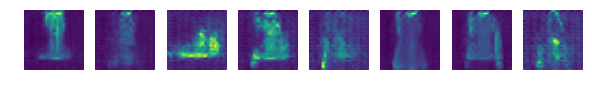

INFO:root:speed: 1242.2506386287068 samples/s
INFO:root:discriminator loss = 0.007918, generator loss = 6.467178, binary training acc = 0.969426 at iter 900 epoch 9


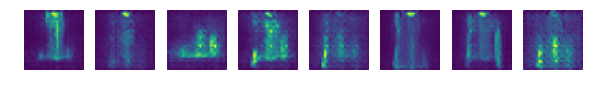

INFO:root:speed: 1244.72755937642 samples/s
INFO:root:discriminator loss = 0.017090, generator loss = 6.962694, binary training acc = 0.968110 at iter 1000 epoch 9


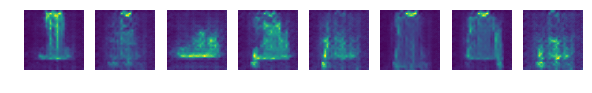

INFO:root:speed: 1187.252678042265 samples/s
INFO:root:discriminator loss = 0.143499, generator loss = 4.377496, binary training acc = 0.965940 at iter 1100 epoch 9


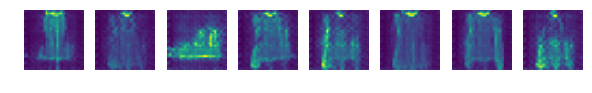

INFO:root:speed: 1187.6518922936705 samples/s
INFO:root:discriminator loss = 0.061488, generator loss = 6.392569, binary training acc = 0.967332 at iter 1200 epoch 9


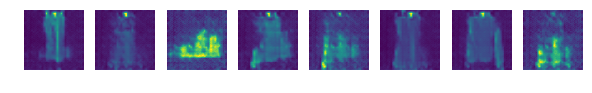

INFO:root:speed: 1279.5070258727526 samples/s
INFO:root:discriminator loss = 0.010811, generator loss = 6.223040, binary training acc = 0.969771 at iter 1300 epoch 9


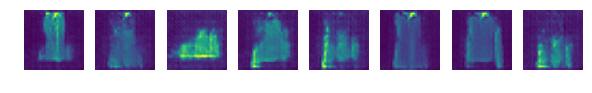

INFO:root:speed: 1196.705731302828 samples/s
INFO:root:discriminator loss = 0.050044, generator loss = 5.619777, binary training acc = 0.965672 at iter 1400 epoch 9


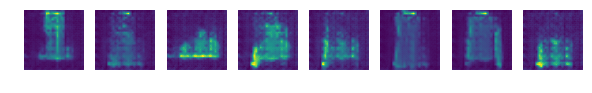

INFO:root:speed: 1270.039061317184 samples/s
INFO:root:discriminator loss = 0.175984, generator loss = 3.391942, binary training acc = 0.965752 at iter 1500 epoch 9


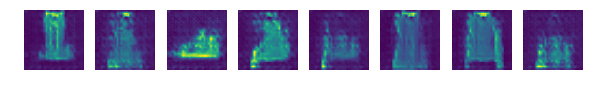

INFO:root:speed: 1185.0094735262178 samples/s
INFO:root:discriminator loss = 0.025792, generator loss = 6.003928, binary training acc = 0.966339 at iter 1600 epoch 9


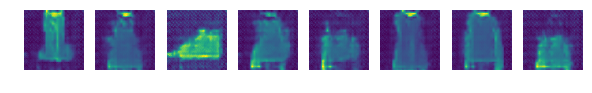

INFO:root:speed: 1190.105587969285 samples/s
INFO:root:discriminator loss = 0.017454, generator loss = 6.177765, binary training acc = 0.968208 at iter 1700 epoch 9


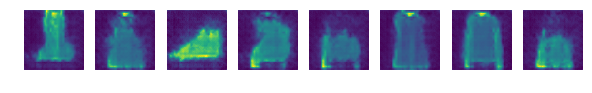

INFO:root:speed: 1272.205952606635 samples/s
INFO:root:discriminator loss = 0.009226, generator loss = 5.640018, binary training acc = 0.969965 at iter 1800 epoch 9


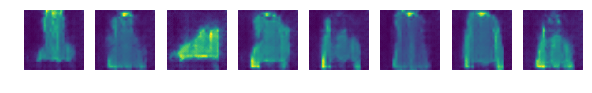

INFO:root:speed: 398.19420528917186 samples/s
INFO:root:discriminator loss = 0.012037, generator loss = 5.838159, binary training acc = 1.000000 at iter 0 epoch 10


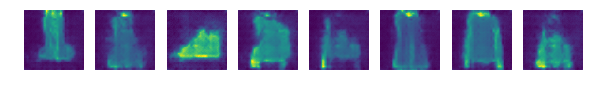

INFO:root:speed: 1307.4386354559358 samples/s
INFO:root:discriminator loss = 0.019367, generator loss = 4.847693, binary training acc = 0.951114 at iter 100 epoch 10


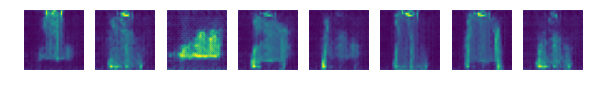

INFO:root:speed: 1233.8002647448154 samples/s
INFO:root:discriminator loss = 0.032973, generator loss = 6.137656, binary training acc = 0.974269 at iter 200 epoch 10


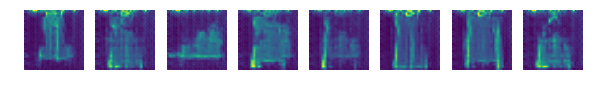

INFO:root:speed: 1269.0903658317495 samples/s
INFO:root:discriminator loss = 0.004474, generator loss = 6.764655, binary training acc = 0.982610 at iter 300 epoch 10


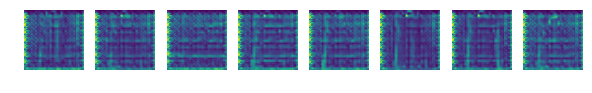

INFO:root:speed: 1273.9327049934982 samples/s
INFO:root:discriminator loss = 0.003409, generator loss = 7.682603, binary training acc = 0.986791 at iter 400 epoch 10


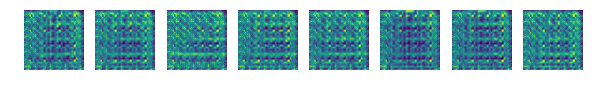

INFO:root:speed: 1196.2790830332633 samples/s
INFO:root:discriminator loss = 0.001360, generator loss = 7.955290, binary training acc = 0.989334 at iter 500 epoch 10


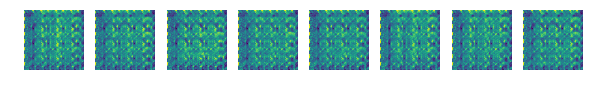

INFO:root:speed: 1250.7942519523606 samples/s
INFO:root:discriminator loss = 0.001477, generator loss = 8.228983, binary training acc = 0.991109 at iter 600 epoch 10


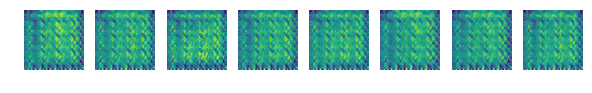

INFO:root:speed: 1205.9636821061144 samples/s
INFO:root:discriminator loss = 0.002084, generator loss = 7.641279, binary training acc = 0.992310 at iter 700 epoch 10


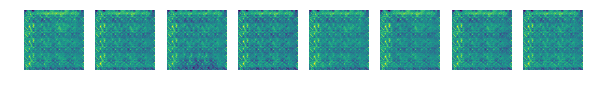

INFO:root:speed: 1204.1784317243855 samples/s
INFO:root:discriminator loss = 0.001146, generator loss = 7.973148, binary training acc = 0.993251 at iter 800 epoch 10


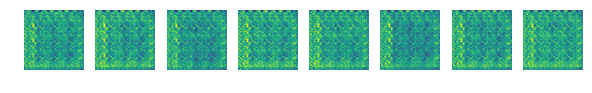

INFO:root:speed: 1220.1500713629875 samples/s
INFO:root:discriminator loss = 0.002667, generator loss = 7.007648, binary training acc = 0.993982 at iter 900 epoch 10


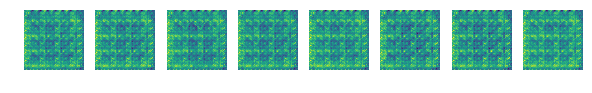

INFO:root:speed: 1250.7825957300083 samples/s
INFO:root:discriminator loss = 0.002524, generator loss = 6.690073, binary training acc = 0.994584 at iter 1000 epoch 10


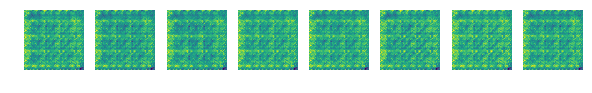

INFO:root:speed: 1199.4970999597838 samples/s
INFO:root:discriminator loss = 0.002722, generator loss = 6.716676, binary training acc = 0.995061 at iter 1100 epoch 10


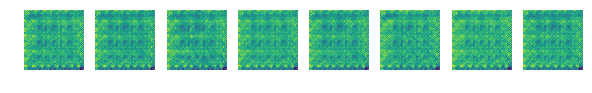

INFO:root:speed: 1233.856976070749 samples/s
INFO:root:discriminator loss = 0.000360, generator loss = 8.550863, binary training acc = 0.995473 at iter 1200 epoch 10


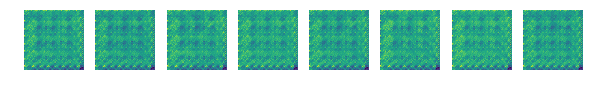

INFO:root:speed: 1282.0124363615523 samples/s
INFO:root:discriminator loss = 0.000280, generator loss = 9.431608, binary training acc = 0.995821 at iter 1300 epoch 10


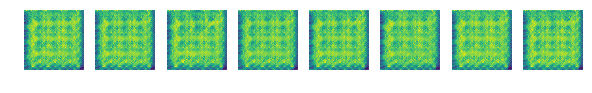

INFO:root:speed: 1255.556441126671 samples/s
INFO:root:discriminator loss = 0.000116, generator loss = 10.224102, binary training acc = 0.996097 at iter 1400 epoch 10


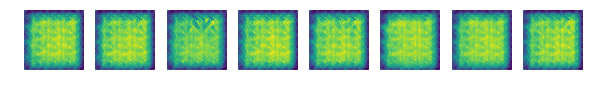

INFO:root:speed: 1107.2242864213827 samples/s
INFO:root:discriminator loss = 0.015255, generator loss = 5.843957, binary training acc = 0.994275 at iter 1500 epoch 10


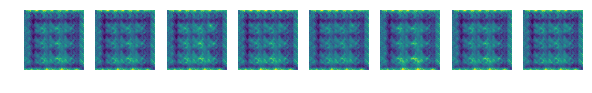

INFO:root:speed: 1113.0733851372083 samples/s
INFO:root:discriminator loss = 0.005034, generator loss = 7.839685, binary training acc = 0.994310 at iter 1600 epoch 10


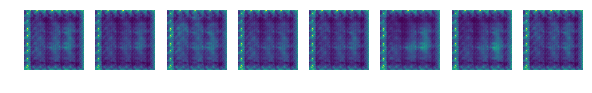

INFO:root:speed: 1253.644878668435 samples/s
INFO:root:discriminator loss = 0.010374, generator loss = 6.828775, binary training acc = 0.994608 at iter 1700 epoch 10


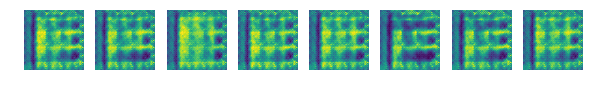

INFO:root:speed: 1203.5953153864089 samples/s
INFO:root:discriminator loss = 0.277666, generator loss = 3.420984, binary training acc = 0.993224 at iter 1800 epoch 10


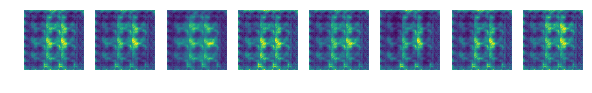

INFO:root:speed: 387.98651765943794 samples/s
INFO:root:discriminator loss = 0.016712, generator loss = 6.694982, binary training acc = 1.000000 at iter 0 epoch 11


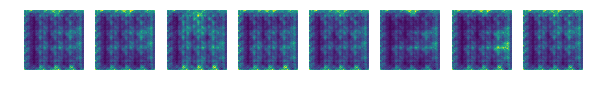

INFO:root:speed: 1261.3618276993054 samples/s
INFO:root:discriminator loss = 0.064376, generator loss = 4.983959, binary training acc = 0.997834 at iter 100 epoch 11


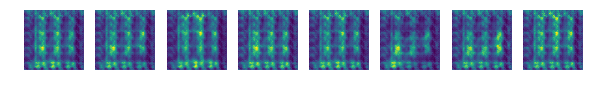

INFO:root:speed: 1236.1183275004605 samples/s
INFO:root:discriminator loss = 0.001504, generator loss = 9.325243, binary training acc = 0.998212 at iter 200 epoch 11


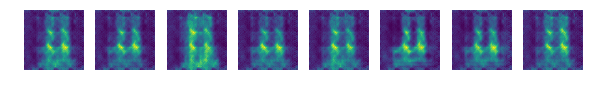

INFO:root:speed: 1278.8730633635064 samples/s
INFO:root:discriminator loss = 0.009831, generator loss = 6.662779, binary training acc = 0.998443 at iter 300 epoch 11


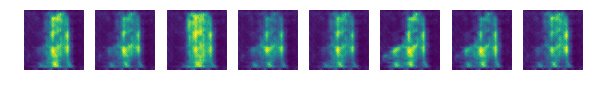

INFO:root:speed: 1260.7457143125523 samples/s
INFO:root:discriminator loss = 0.012535, generator loss = 6.739722, binary training acc = 0.998558 at iter 400 epoch 11


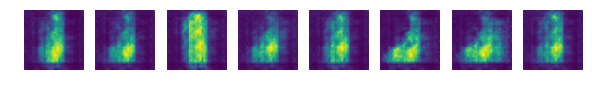

INFO:root:speed: 1277.3030576994452 samples/s
INFO:root:discriminator loss = 0.001842, generator loss = 8.890631, binary training acc = 0.995259 at iter 500 epoch 11


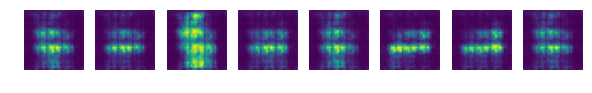

INFO:root:speed: 1196.0978496252662 samples/s
INFO:root:discriminator loss = 0.076639, generator loss = 4.960890, binary training acc = 0.995398 at iter 600 epoch 11


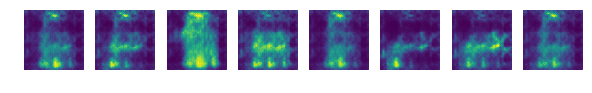

INFO:root:speed: 1178.8582570660672 samples/s
INFO:root:discriminator loss = 0.006501, generator loss = 6.033817, binary training acc = 0.995765 at iter 700 epoch 11


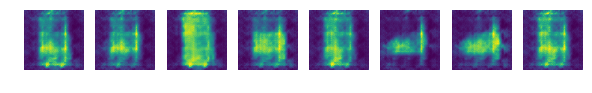

INFO:root:speed: 1279.555818254619 samples/s
INFO:root:discriminator loss = 0.011448, generator loss = 6.414028, binary training acc = 0.996235 at iter 800 epoch 11


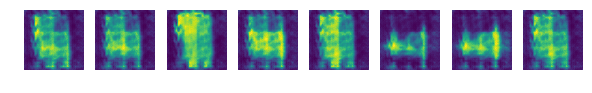

INFO:root:speed: 1145.4663446357097 samples/s
INFO:root:discriminator loss = 0.016431, generator loss = 6.500900, binary training acc = 0.994416 at iter 900 epoch 11


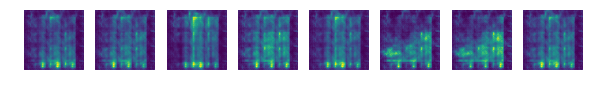

INFO:root:speed: 1254.2892334146363 samples/s
INFO:root:discriminator loss = 0.022819, generator loss = 6.944279, binary training acc = 0.994615 at iter 1000 epoch 11


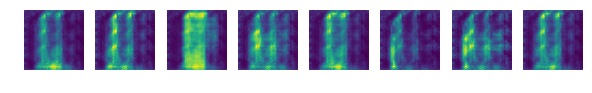

INFO:root:speed: 1165.2867511720785 samples/s
INFO:root:discriminator loss = 0.010845, generator loss = 7.048667, binary training acc = 0.994891 at iter 1100 epoch 11


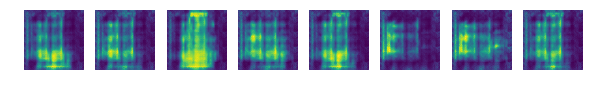

INFO:root:speed: 1231.1407002449114 samples/s
INFO:root:discriminator loss = 0.006125, generator loss = 5.678529, binary training acc = 0.994887 at iter 1200 epoch 11


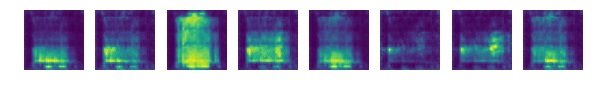

INFO:root:speed: 1195.0222412165892 samples/s
INFO:root:discriminator loss = 0.005476, generator loss = 6.575264, binary training acc = 0.994355 at iter 1300 epoch 11


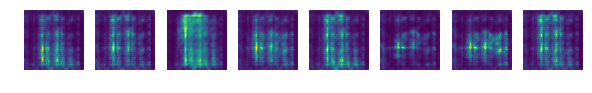

INFO:root:speed: 1098.1021214625246 samples/s
INFO:root:discriminator loss = 0.019779, generator loss = 5.616703, binary training acc = 0.994624 at iter 1400 epoch 11


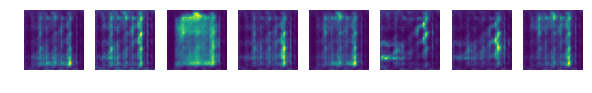

INFO:root:speed: 1078.0800179924015 samples/s
INFO:root:discriminator loss = 0.005986, generator loss = 7.838080, binary training acc = 0.994858 at iter 1500 epoch 11


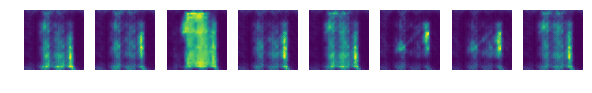

INFO:root:speed: 1242.4461292084386 samples/s
INFO:root:discriminator loss = 0.005612, generator loss = 6.774069, binary training acc = 0.995003 at iter 1600 epoch 11


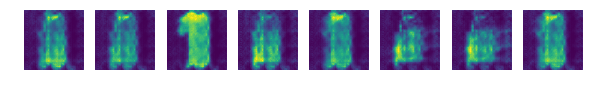

INFO:root:speed: 1196.1191683524787 samples/s
INFO:root:discriminator loss = 0.003659, generator loss = 12.436796, binary training acc = 0.995141 at iter 1700 epoch 11


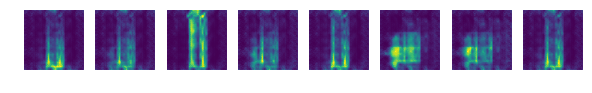

INFO:root:speed: 1267.1852565191941 samples/s
INFO:root:discriminator loss = 0.010892, generator loss = 6.485253, binary training acc = 0.994873 at iter 1800 epoch 11


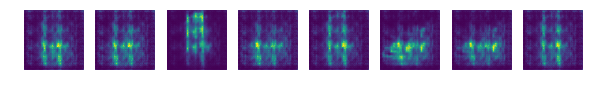

INFO:root:speed: 393.47921607716097 samples/s
INFO:root:discriminator loss = 0.016969, generator loss = 8.269249, binary training acc = 1.000000 at iter 0 epoch 12


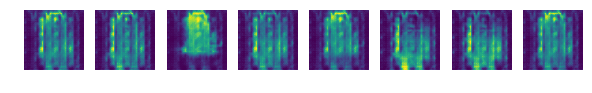

INFO:root:speed: 1180.3718999542689 samples/s
INFO:root:discriminator loss = 0.023601, generator loss = 5.491952, binary training acc = 0.999072 at iter 100 epoch 12


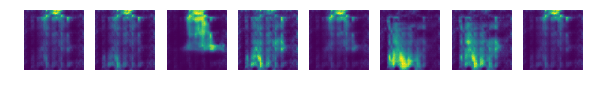

INFO:root:speed: 1266.4678329464605 samples/s
INFO:root:discriminator loss = 0.008205, generator loss = 6.118226, binary training acc = 0.999378 at iter 200 epoch 12


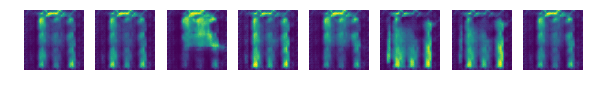

INFO:root:speed: 1181.5460891764603 samples/s
INFO:root:discriminator loss = 0.002713, generator loss = 7.627287, binary training acc = 0.999325 at iter 300 epoch 12


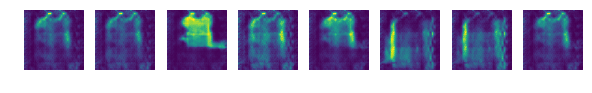

INFO:root:speed: 1006.2053227378365 samples/s
INFO:root:discriminator loss = 0.023643, generator loss = 6.880646, binary training acc = 0.998558 at iter 400 epoch 12


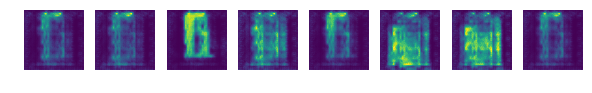

INFO:root:speed: 1271.2419776472816 samples/s
INFO:root:discriminator loss = 0.010889, generator loss = 5.987208, binary training acc = 0.993419 at iter 500 epoch 12


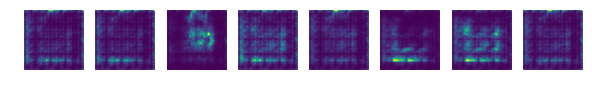

INFO:root:speed: 1197.3355932808192 samples/s
INFO:root:discriminator loss = 0.019571, generator loss = 5.299719, binary training acc = 0.993656 at iter 600 epoch 12


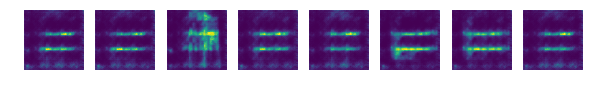

INFO:root:speed: 1219.64004470817 samples/s
INFO:root:discriminator loss = 0.006066, generator loss = 7.107413, binary training acc = 0.994294 at iter 700 epoch 12


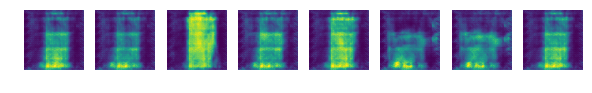

INFO:root:speed: 1107.9829284198881 samples/s
INFO:root:discriminator loss = 0.008076, generator loss = 6.553176, binary training acc = 0.994811 at iter 800 epoch 12


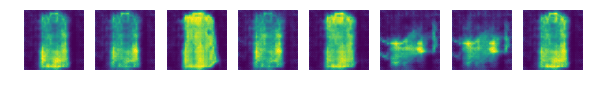

INFO:root:speed: 1216.7873441820407 samples/s
INFO:root:discriminator loss = 0.021394, generator loss = 5.419127, binary training acc = 0.995231 at iter 900 epoch 12


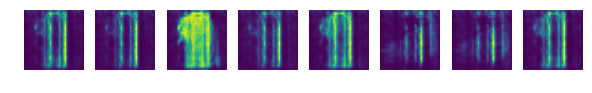

INFO:root:speed: 1217.515833779334 samples/s
INFO:root:discriminator loss = 0.097894, generator loss = 5.176810, binary training acc = 0.993553 at iter 1000 epoch 12


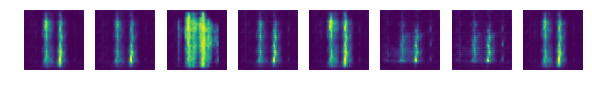

INFO:root:speed: 1111.948369992958 samples/s
INFO:root:discriminator loss = 0.058593, generator loss = 5.918689, binary training acc = 0.992776 at iter 1100 epoch 12


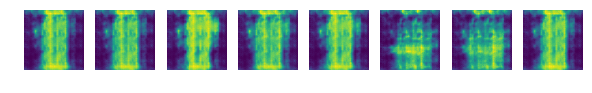

INFO:root:speed: 1259.1135585429233 samples/s
INFO:root:discriminator loss = 0.010023, generator loss = 6.621504, binary training acc = 0.993235 at iter 1200 epoch 12


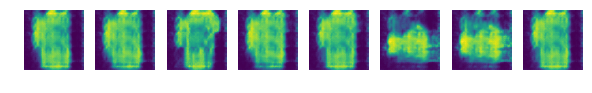

INFO:root:speed: 1227.8519819597295 samples/s
INFO:root:discriminator loss = 0.003610, generator loss = 7.340284, binary training acc = 0.993563 at iter 1300 epoch 12


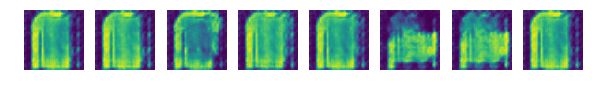

INFO:root:speed: 1267.7478062925636 samples/s
INFO:root:discriminator loss = 0.012782, generator loss = 7.021489, binary training acc = 0.993643 at iter 1400 epoch 12


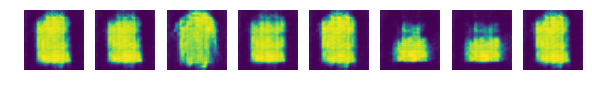

INFO:root:speed: 1237.1551770225553 samples/s
INFO:root:discriminator loss = 0.035082, generator loss = 4.854564, binary training acc = 0.994004 at iter 1500 epoch 12


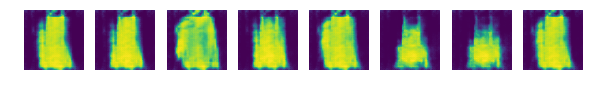

INFO:root:speed: 1084.04458372371 samples/s
INFO:root:discriminator loss = 0.287200, generator loss = 2.232910, binary training acc = 0.994291 at iter 1600 epoch 12


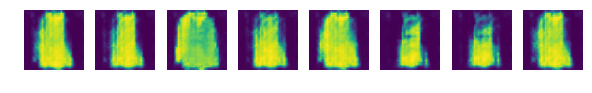

INFO:root:speed: 1232.3162833402193 samples/s
INFO:root:discriminator loss = 0.005662, generator loss = 6.165128, binary training acc = 0.994498 at iter 1700 epoch 12


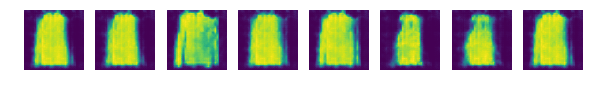

INFO:root:speed: 1245.189472024047 samples/s
INFO:root:discriminator loss = 0.016260, generator loss = 7.415097, binary training acc = 0.994725 at iter 1800 epoch 12


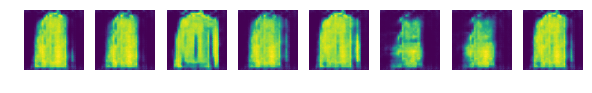

INFO:root:speed: 397.36544206247464 samples/s
INFO:root:discriminator loss = 0.063748, generator loss = 5.835552, binary training acc = 1.000000 at iter 0 epoch 13


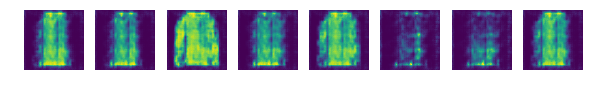

INFO:root:speed: 1242.492135934014 samples/s
INFO:root:discriminator loss = 0.002058, generator loss = 6.414219, binary training acc = 0.993967 at iter 100 epoch 13


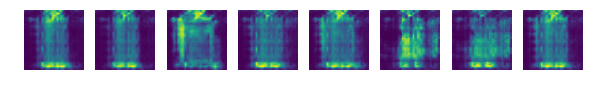

INFO:root:speed: 1245.7095337095336 samples/s
INFO:root:discriminator loss = 0.044408, generator loss = 6.650365, binary training acc = 0.988650 at iter 200 epoch 13


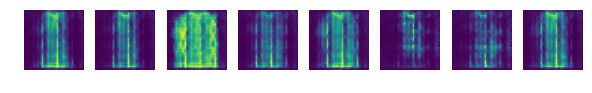

INFO:root:speed: 1204.329702277336 samples/s
INFO:root:discriminator loss = 0.620082, generator loss = 13.394962, binary training acc = 0.988424 at iter 300 epoch 13


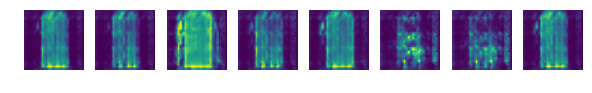

INFO:root:speed: 1210.9251075884843 samples/s
INFO:root:discriminator loss = 0.123466, generator loss = 4.261789, binary training acc = 0.987882 at iter 400 epoch 13


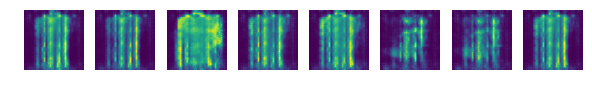

INFO:root:speed: 1255.5094618485916 samples/s
INFO:root:discriminator loss = 0.043777, generator loss = 5.877346, binary training acc = 0.987587 at iter 500 epoch 13


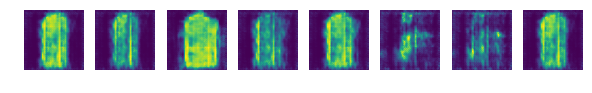

INFO:root:speed: 1253.5512094891192 samples/s
INFO:root:discriminator loss = 0.041061, generator loss = 6.215681, binary training acc = 0.989055 at iter 600 epoch 13


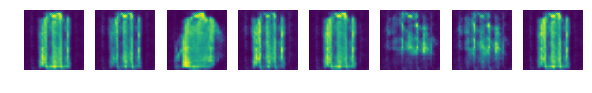

INFO:root:speed: 768.2095298056836 samples/s
INFO:root:discriminator loss = 0.007398, generator loss = 6.192721, binary training acc = 0.990237 at iter 700 epoch 13


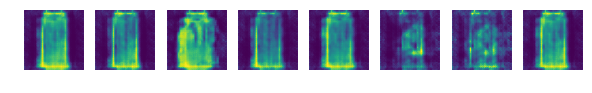

INFO:root:speed: 1250.8408790143706 samples/s
INFO:root:discriminator loss = 0.010335, generator loss = 7.366784, binary training acc = 0.991163 at iter 800 epoch 13


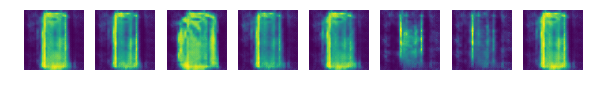

INFO:root:speed: 1271.7840337328848 samples/s
INFO:root:discriminator loss = 0.002578, generator loss = 6.411558, binary training acc = 0.991901 at iter 900 epoch 13


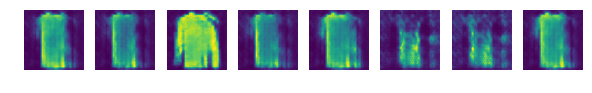

INFO:root:speed: 1186.1719457013576 samples/s
INFO:root:discriminator loss = 0.063876, generator loss = 15.971289, binary training acc = 0.991118 at iter 1000 epoch 13


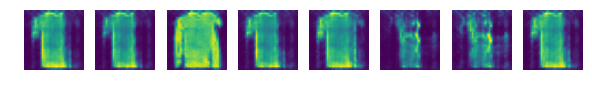

INFO:root:speed: 1238.719432959244 samples/s
INFO:root:discriminator loss = 0.004492, generator loss = 7.590991, binary training acc = 0.991201 at iter 1100 epoch 13


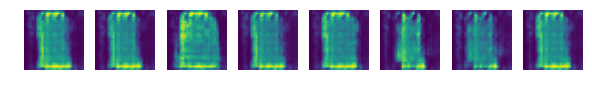

INFO:root:speed: 1263.522974817604 samples/s
INFO:root:discriminator loss = 0.032486, generator loss = 5.980165, binary training acc = 0.991530 at iter 1200 epoch 13


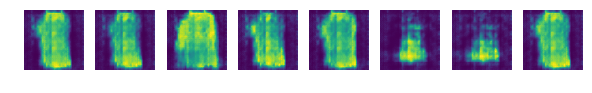

INFO:root:speed: 1197.0045662100456 samples/s
INFO:root:discriminator loss = 0.006733, generator loss = 10.604704, binary training acc = 0.992037 at iter 1300 epoch 13


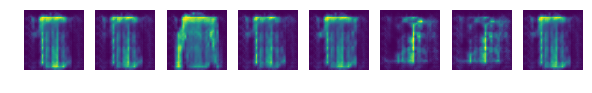

INFO:root:speed: 1266.9340658303363 samples/s
INFO:root:discriminator loss = 0.032336, generator loss = 6.547170, binary training acc = 0.991602 at iter 1400 epoch 13


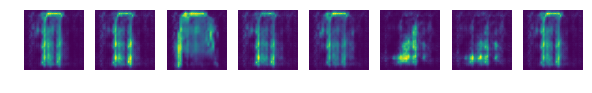

INFO:root:speed: 1221.827291761493 samples/s
INFO:root:discriminator loss = 0.006192, generator loss = 7.595699, binary training acc = 0.991787 at iter 1500 epoch 13


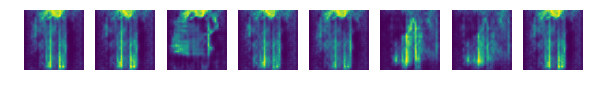

INFO:root:speed: 1180.4549516270888 samples/s
INFO:root:discriminator loss = 0.012938, generator loss = 5.038622, binary training acc = 0.992231 at iter 1600 epoch 13


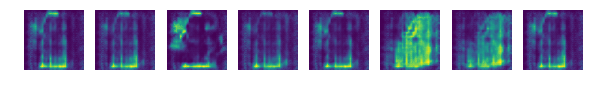

INFO:root:speed: 1237.7142014016968 samples/s
INFO:root:discriminator loss = 0.002795, generator loss = 7.359252, binary training acc = 0.992550 at iter 1700 epoch 13


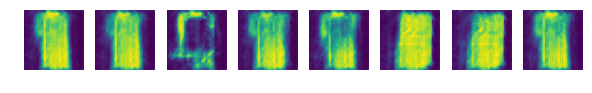

INFO:root:speed: 1268.7184800075622 samples/s
INFO:root:discriminator loss = 0.003262, generator loss = 11.864643, binary training acc = 0.992756 at iter 1800 epoch 13


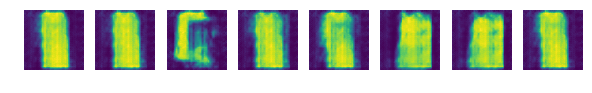

INFO:root:speed: 380.9086337346252 samples/s
INFO:root:discriminator loss = 0.019739, generator loss = 7.120574, binary training acc = 1.000000 at iter 0 epoch 14


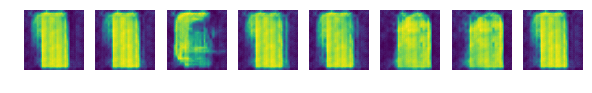

INFO:root:speed: 1309.2751943655926 samples/s
INFO:root:discriminator loss = 0.001282, generator loss = 8.011902, binary training acc = 0.999381 at iter 100 epoch 14


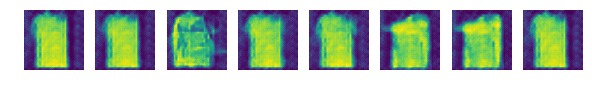

INFO:root:speed: 1243.2287071943979 samples/s
INFO:root:discriminator loss = 0.010540, generator loss = 5.776157, binary training acc = 0.999378 at iter 200 epoch 14


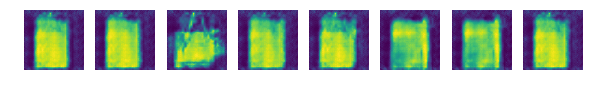

INFO:root:speed: 1114.1636823973768 samples/s
INFO:root:discriminator loss = 0.000929, generator loss = 8.920446, binary training acc = 0.998962 at iter 300 epoch 14


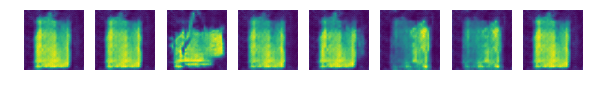

INFO:root:speed: 1276.3434831396564 samples/s
INFO:root:discriminator loss = 0.001542, generator loss = 8.461497, binary training acc = 0.999065 at iter 400 epoch 14


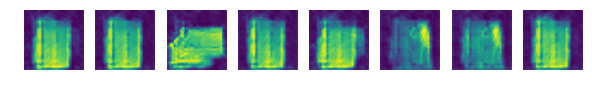

INFO:root:speed: 1186.1404975476116 samples/s
INFO:root:discriminator loss = 0.006967, generator loss = 6.820777, binary training acc = 0.999096 at iter 500 epoch 14


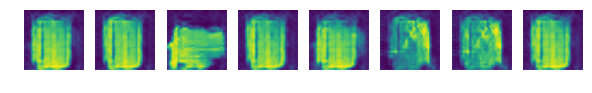

INFO:root:speed: 1259.6689629282027 samples/s
INFO:root:discriminator loss = 0.014472, generator loss = 6.604733, binary training acc = 0.998830 at iter 600 epoch 14


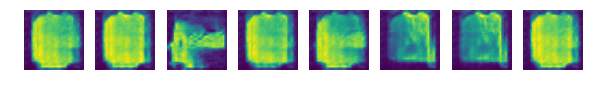

INFO:root:speed: 1259.6453187176214 samples/s
INFO:root:discriminator loss = 0.016411, generator loss = 5.992497, binary training acc = 0.997392 at iter 700 epoch 14


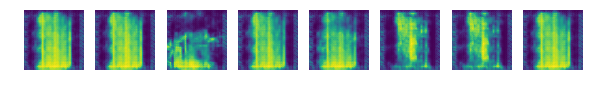

INFO:root:speed: 1258.5940491930871 samples/s
INFO:root:discriminator loss = 0.006862, generator loss = 6.594403, binary training acc = 0.997620 at iter 800 epoch 14


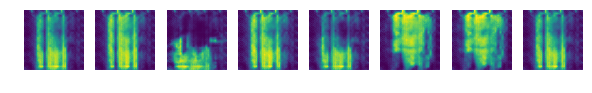

INFO:root:speed: 1184.6956828753762 samples/s
INFO:root:discriminator loss = 0.010214, generator loss = 7.935279, binary training acc = 0.997676 at iter 900 epoch 14


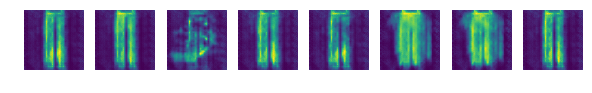

INFO:root:speed: 1257.697723886541 samples/s
INFO:root:discriminator loss = 0.005071, generator loss = 7.091430, binary training acc = 0.997206 at iter 1000 epoch 14


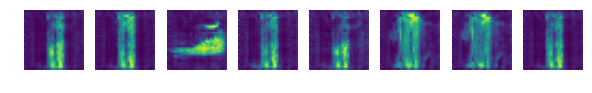

INFO:root:speed: 1238.4108360475739 samples/s
INFO:root:discriminator loss = 0.032660, generator loss = 5.388651, binary training acc = 0.995246 at iter 1100 epoch 14


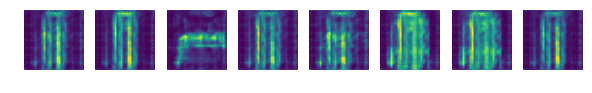

INFO:root:speed: 1257.3089274004683 samples/s
INFO:root:discriminator loss = 0.033997, generator loss = 6.696855, binary training acc = 0.995342 at iter 1200 epoch 14


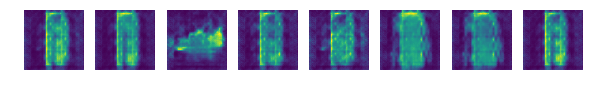

INFO:root:speed: 1257.0380901538779 samples/s
INFO:root:discriminator loss = 0.024361, generator loss = 4.930083, binary training acc = 0.994223 at iter 1300 epoch 14


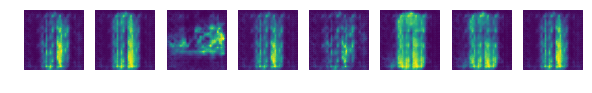

INFO:root:speed: 1107.251689119513 samples/s
INFO:root:discriminator loss = 0.004082, generator loss = 11.687361, binary training acc = 0.993955 at iter 1400 epoch 14


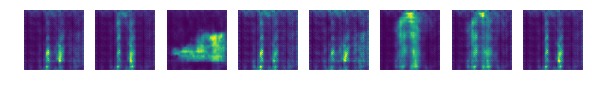

INFO:root:speed: 1271.8683951178834 samples/s
INFO:root:discriminator loss = 0.006398, generator loss = 9.955082, binary training acc = 0.994046 at iter 1500 epoch 14


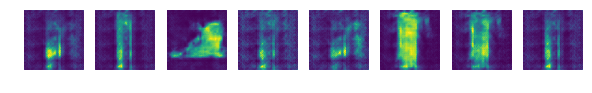

INFO:root:speed: 1253.4926733597945 samples/s
INFO:root:discriminator loss = 0.007167, generator loss = 6.783972, binary training acc = 0.994252 at iter 1600 epoch 14


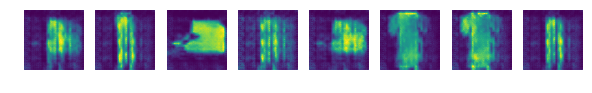

INFO:root:speed: 1186.1614627981583 samples/s
INFO:root:discriminator loss = 0.022974, generator loss = 5.288482, binary training acc = 0.994461 at iter 1700 epoch 14


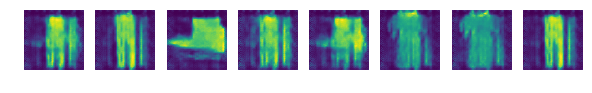

INFO:root:speed: 1028.393772220179 samples/s
INFO:root:discriminator loss = 0.006027, generator loss = 6.986491, binary training acc = 0.994690 at iter 1800 epoch 14


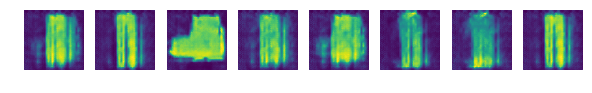

INFO:root:speed: 388.1424774794315 samples/s
INFO:root:discriminator loss = 0.006513, generator loss = 5.739305, binary training acc = 1.000000 at iter 0 epoch 15


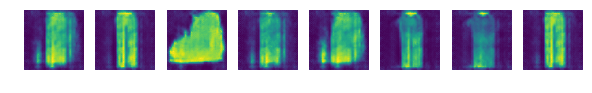

INFO:root:speed: 1266.778616732105 samples/s
INFO:root:discriminator loss = 0.011073, generator loss = 5.563937, binary training acc = 0.997989 at iter 100 epoch 15


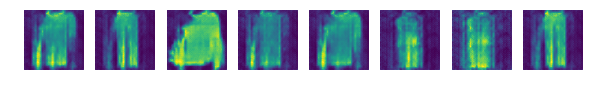

INFO:root:speed: 1260.8167735996167 samples/s
INFO:root:discriminator loss = 0.198717, generator loss = 6.855670, binary training acc = 0.987562 at iter 200 epoch 15


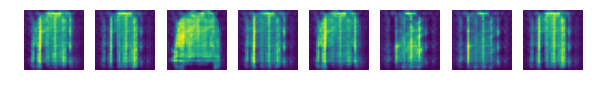

INFO:root:speed: 1083.685724205308 samples/s
INFO:root:discriminator loss = 0.011798, generator loss = 11.940903, binary training acc = 0.989826 at iter 300 epoch 15


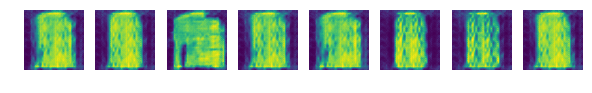

INFO:root:speed: 1276.307072013389 samples/s
INFO:root:discriminator loss = 0.040266, generator loss = 8.152816, binary training acc = 0.991194 at iter 400 epoch 15


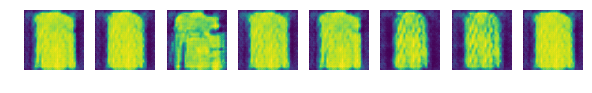

INFO:root:speed: 1268.226965633888 samples/s
INFO:root:discriminator loss = 0.034121, generator loss = 7.830973, binary training acc = 0.990924 at iter 500 epoch 15


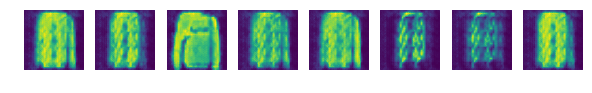

INFO:root:speed: 1170.867636154269 samples/s
INFO:root:discriminator loss = 0.023726, generator loss = 5.635800, binary training acc = 0.990303 at iter 600 epoch 15


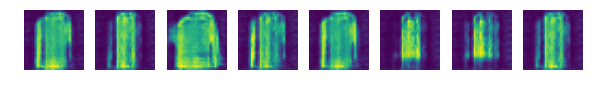

INFO:root:speed: 1252.9660941000748 samples/s
INFO:root:discriminator loss = 0.006062, generator loss = 7.664759, binary training acc = 0.991374 at iter 700 epoch 15


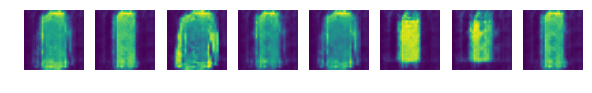

INFO:root:speed: 1274.343951463593 samples/s
INFO:root:discriminator loss = 0.098026, generator loss = 5.549257, binary training acc = 0.991768 at iter 800 epoch 15


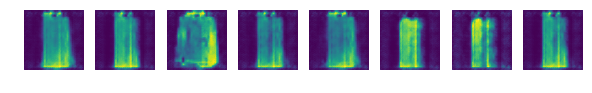

INFO:root:speed: 1245.0624118738403 samples/s
INFO:root:discriminator loss = 0.005217, generator loss = 7.919749, binary training acc = 0.991398 at iter 900 epoch 15


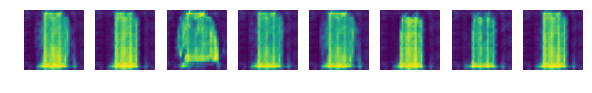

INFO:root:speed: 1266.694929170717 samples/s
INFO:root:discriminator loss = 0.006799, generator loss = 6.517619, binary training acc = 0.991743 at iter 1000 epoch 15


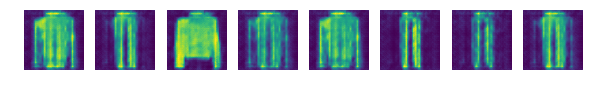

INFO:root:speed: 880.3067417867474 samples/s
INFO:root:discriminator loss = 0.102728, generator loss = 9.299597, binary training acc = 0.991414 at iter 1100 epoch 15


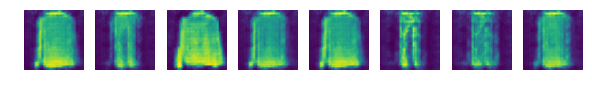

INFO:root:speed: 1173.6422525358516 samples/s
INFO:root:discriminator loss = 0.021234, generator loss = 5.826291, binary training acc = 0.990347 at iter 1200 epoch 15


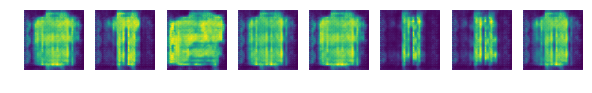

INFO:root:speed: 1262.7978096833074 samples/s
INFO:root:discriminator loss = 0.181015, generator loss = 1.973431, binary training acc = 0.990692 at iter 1300 epoch 15


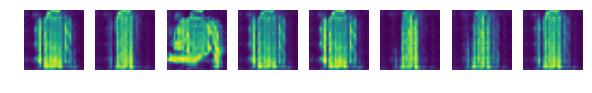

INFO:root:speed: 1103.0203974293652 samples/s
INFO:root:discriminator loss = 0.012062, generator loss = 5.237167, binary training acc = 0.991089 at iter 1400 epoch 15


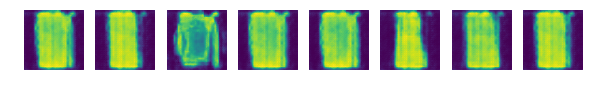

INFO:root:speed: 869.781533516512 samples/s
INFO:root:discriminator loss = 0.012847, generator loss = 5.924333, binary training acc = 0.991547 at iter 1500 epoch 15


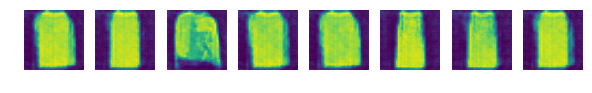

INFO:root:speed: 1060.2805027372478 samples/s
INFO:root:discriminator loss = 0.002670, generator loss = 8.522261, binary training acc = 0.991987 at iter 1600 epoch 15


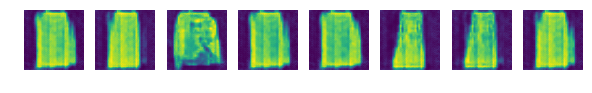

INFO:root:speed: 1170.9187095423376 samples/s
INFO:root:discriminator loss = 0.002568, generator loss = 7.769051, binary training acc = 0.992385 at iter 1700 epoch 15


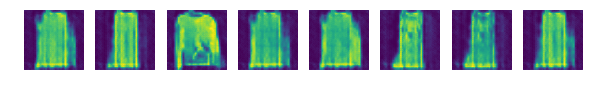

INFO:root:speed: 1098.6234478468352 samples/s
INFO:root:discriminator loss = 0.123521, generator loss = 7.539475, binary training acc = 0.991975 at iter 1800 epoch 15


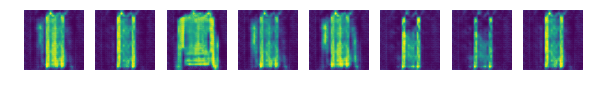

INFO:root:speed: 391.19013934672296 samples/s
INFO:root:discriminator loss = 0.129001, generator loss = 1.978154, binary training acc = 0.937500 at iter 0 epoch 16


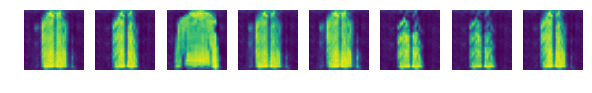

INFO:root:speed: 1177.7307371690813 samples/s
INFO:root:discriminator loss = 0.007690, generator loss = 6.852715, binary training acc = 0.985303 at iter 100 epoch 16


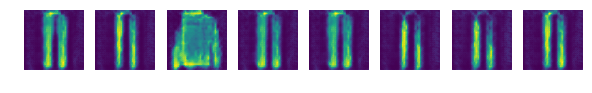

INFO:root:speed: 1108.3489103776312 samples/s
INFO:root:discriminator loss = 0.059623, generator loss = 7.579121, binary training acc = 0.991138 at iter 200 epoch 16


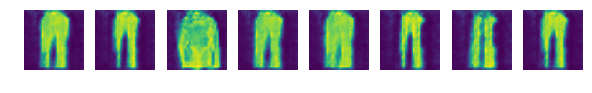

INFO:root:speed: 1263.2613438497087 samples/s
INFO:root:discriminator loss = 0.002896, generator loss = 8.494122, binary training acc = 0.993148 at iter 300 epoch 16


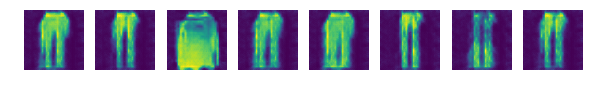

INFO:root:speed: 1248.7460970208965 samples/s
INFO:root:discriminator loss = 0.003339, generator loss = 7.702314, binary training acc = 0.994584 at iter 400 epoch 16


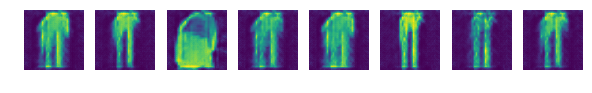

INFO:root:speed: 1259.8581485722868 samples/s
INFO:root:discriminator loss = 0.004893, generator loss = 6.597097, binary training acc = 0.995228 at iter 500 epoch 16


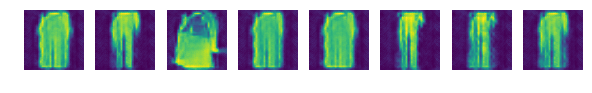

INFO:root:speed: 1263.6776258803147 samples/s
INFO:root:discriminator loss = 0.001747, generator loss = 7.421945, binary training acc = 0.995840 at iter 600 epoch 16


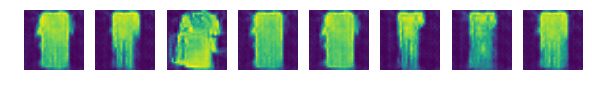

INFO:root:speed: 1244.4274998841036 samples/s
INFO:root:discriminator loss = 0.003768, generator loss = 7.474999, binary training acc = 0.996077 at iter 700 epoch 16


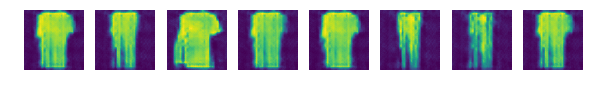

INFO:root:speed: 1248.5021627303424 samples/s
INFO:root:discriminator loss = 0.076010, generator loss = 7.165496, binary training acc = 0.994109 at iter 800 epoch 16


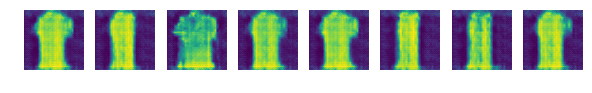

INFO:root:speed: 1279.0436837691545 samples/s
INFO:root:discriminator loss = 0.007824, generator loss = 6.479694, binary training acc = 0.994468 at iter 900 epoch 16


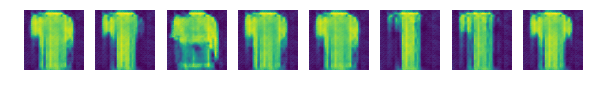

INFO:root:speed: 1271.8081358437646 samples/s
INFO:root:discriminator loss = 0.003313, generator loss = 7.650891, binary training acc = 0.994615 at iter 1000 epoch 16


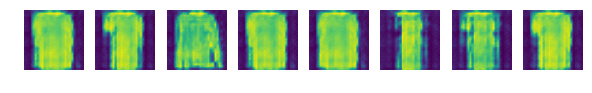

INFO:root:speed: 1258.8419433502156 samples/s
INFO:root:discriminator loss = 0.004929, generator loss = 7.455169, binary training acc = 0.994550 at iter 1100 epoch 16


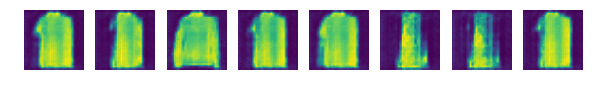

INFO:root:speed: 1237.3148467388799 samples/s
INFO:root:discriminator loss = 0.012465, generator loss = 6.228647, binary training acc = 0.994471 at iter 1200 epoch 16


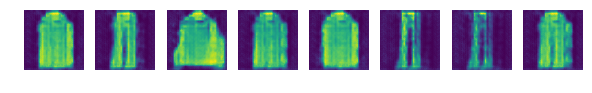

INFO:root:speed: 1210.5865247587265 samples/s
INFO:root:discriminator loss = 0.040071, generator loss = 7.514883, binary training acc = 0.993322 at iter 1300 epoch 16


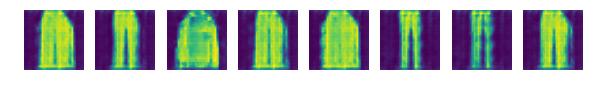

INFO:root:speed: 1182.9310958735084 samples/s
INFO:root:discriminator loss = 0.001764, generator loss = 13.519369, binary training acc = 0.991758 at iter 1400 epoch 16


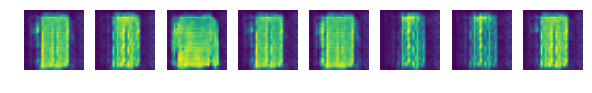

INFO:root:speed: 1246.0217792920337 samples/s
INFO:root:discriminator loss = 0.004834, generator loss = 7.158553, binary training acc = 0.991912 at iter 1500 epoch 16


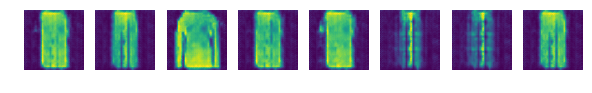

INFO:root:speed: 1269.1383669802847 samples/s
INFO:root:discriminator loss = 0.017146, generator loss = 5.485494, binary training acc = 0.991373 at iter 1600 epoch 16


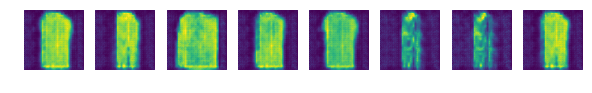

INFO:root:speed: 1236.5738713838216 samples/s
INFO:root:discriminator loss = 0.012006, generator loss = 6.210551, binary training acc = 0.991714 at iter 1700 epoch 16


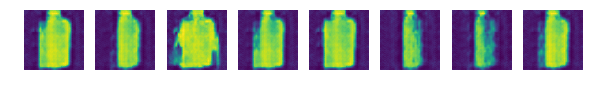

INFO:root:speed: 1236.9955485101793 samples/s
INFO:root:discriminator loss = 0.009628, generator loss = 6.113140, binary training acc = 0.992044 at iter 1800 epoch 16


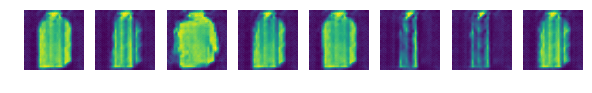

INFO:root:speed: 397.71986677255325 samples/s
INFO:root:discriminator loss = 0.024042, generator loss = 5.395406, binary training acc = 1.000000 at iter 0 epoch 17


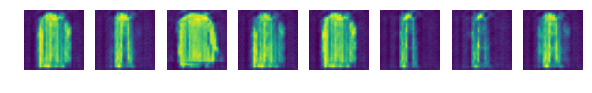

INFO:root:speed: 1273.1593136092429 samples/s
INFO:root:discriminator loss = 0.018756, generator loss = 5.810717, binary training acc = 0.993502 at iter 100 epoch 17


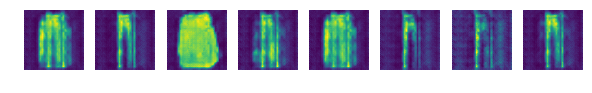

INFO:root:speed: 1243.989211533649 samples/s
INFO:root:discriminator loss = 0.009436, generator loss = 7.490570, binary training acc = 0.993470 at iter 200 epoch 17


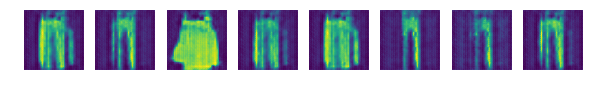

INFO:root:speed: 1224.3350330672747 samples/s
INFO:root:discriminator loss = 0.004269, generator loss = 7.857784, binary training acc = 0.994757 at iter 300 epoch 17


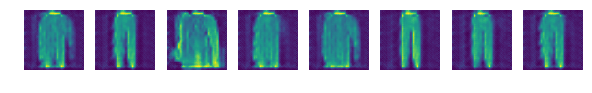

INFO:root:speed: 1269.6786302147384 samples/s
INFO:root:discriminator loss = 7.905886, generator loss = 14.546141, binary training acc = 0.994116 at iter 400 epoch 17


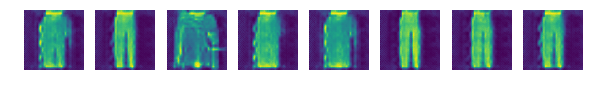

INFO:root:speed: 1189.304127456714 samples/s
INFO:root:discriminator loss = 0.005959, generator loss = 7.167618, binary training acc = 0.991486 at iter 500 epoch 17


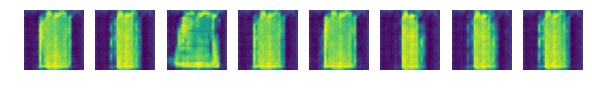

INFO:root:speed: 1237.1893884925244 samples/s
INFO:root:discriminator loss = 0.012417, generator loss = 5.077866, binary training acc = 0.991889 at iter 600 epoch 17


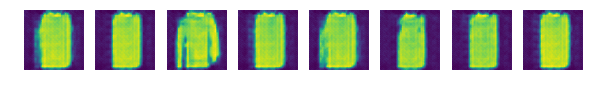

INFO:root:speed: 1260.3905379898392 samples/s
INFO:root:discriminator loss = 0.008025, generator loss = 7.038753, binary training acc = 0.991619 at iter 700 epoch 17


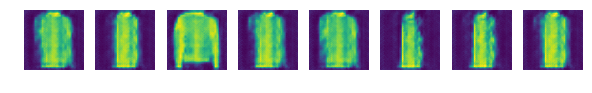

INFO:root:speed: 1275.4095880648074 samples/s
INFO:root:discriminator loss = 0.022578, generator loss = 4.948299, binary training acc = 0.990812 at iter 800 epoch 17


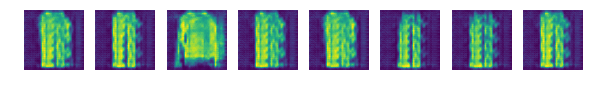

INFO:root:speed: 1242.6877025350443 samples/s
INFO:root:discriminator loss = 0.018714, generator loss = 5.574199, binary training acc = 0.991329 at iter 900 epoch 17


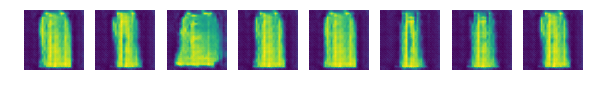

INFO:root:speed: 1224.0558869129047 samples/s
INFO:root:discriminator loss = 0.001753, generator loss = 7.340812, binary training acc = 0.991930 at iter 1000 epoch 17


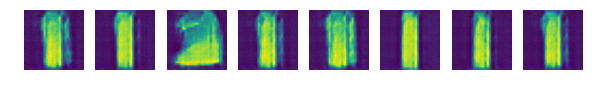

INFO:root:speed: 1186.801259151841 samples/s
INFO:root:discriminator loss = 0.027633, generator loss = 5.361179, binary training acc = 0.992549 at iter 1100 epoch 17


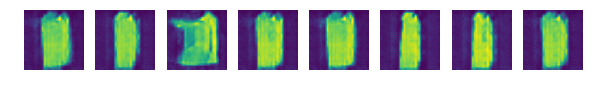

INFO:root:speed: 1156.4611792278065 samples/s
INFO:root:discriminator loss = 0.057854, generator loss = 4.169718, binary training acc = 0.993105 at iter 1200 epoch 17


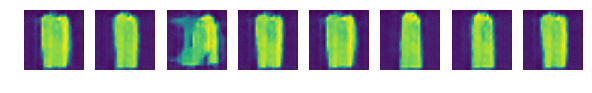

INFO:root:speed: 1254.9811871189736 samples/s
INFO:root:discriminator loss = 0.000728, generator loss = 8.988980, binary training acc = 0.993515 at iter 1300 epoch 17


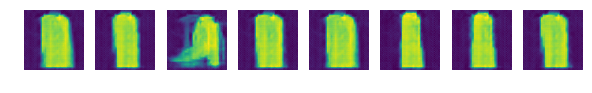

INFO:root:speed: 1271.2660592168822 samples/s
INFO:root:discriminator loss = 0.009913, generator loss = 5.812502, binary training acc = 0.993855 at iter 1400 epoch 17


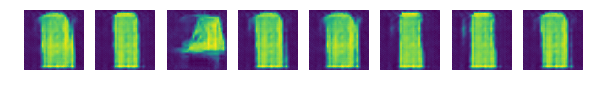

INFO:root:speed: 1230.4296584221045 samples/s
INFO:root:discriminator loss = 0.004871, generator loss = 6.299146, binary training acc = 0.994181 at iter 1500 epoch 17


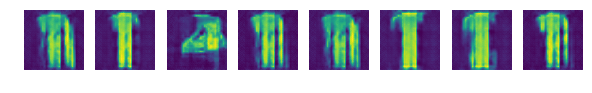

INFO:root:speed: 1190.6123303468464 samples/s
INFO:root:discriminator loss = 0.022187, generator loss = 5.893360, binary training acc = 0.992993 at iter 1600 epoch 17


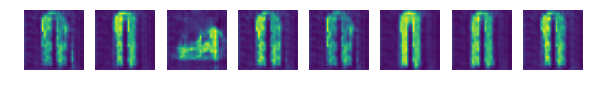

INFO:root:speed: 1239.5545581322324 samples/s
INFO:root:discriminator loss = 0.002907, generator loss = 6.505293, binary training acc = 0.993203 at iter 1700 epoch 17


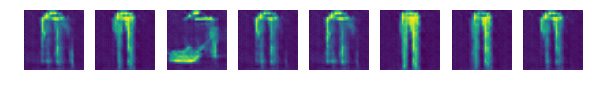

INFO:root:speed: 1269.0783661119515 samples/s
INFO:root:discriminator loss = 0.049295, generator loss = 5.355512, binary training acc = 0.993502 at iter 1800 epoch 17


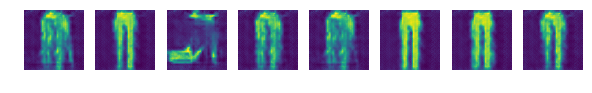

INFO:root:speed: 386.1180640261444 samples/s
INFO:root:discriminator loss = 0.001107, generator loss = 10.097878, binary training acc = 1.000000 at iter 0 epoch 18


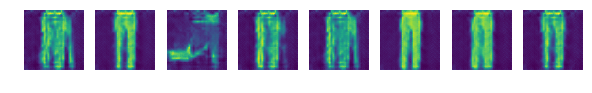

INFO:root:speed: 1228.0204948031035 samples/s
INFO:root:discriminator loss = 0.229603, generator loss = 18.783257, binary training acc = 0.983137 at iter 100 epoch 18


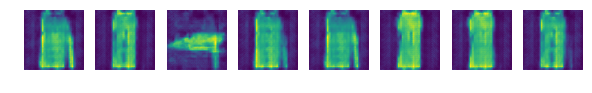

INFO:root:speed: 1261.5870962890551 samples/s
INFO:root:discriminator loss = 0.014360, generator loss = 5.289978, binary training acc = 0.987562 at iter 200 epoch 18


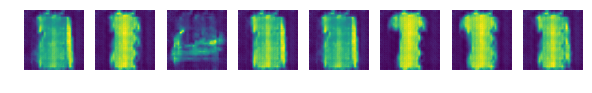

INFO:root:speed: 1271.1456604917225 samples/s
INFO:root:discriminator loss = 0.004932, generator loss = 8.356245, binary training acc = 0.989358 at iter 300 epoch 18


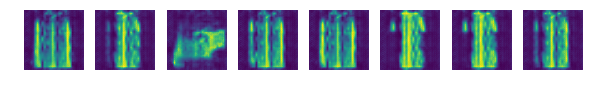

INFO:root:speed: 1277.7286470431438 samples/s
INFO:root:discriminator loss = 0.000966, generator loss = 9.979445, binary training acc = 0.990765 at iter 400 epoch 18


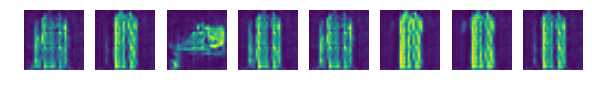

INFO:root:speed: 1196.7910974783322 samples/s
INFO:root:discriminator loss = 0.046079, generator loss = 7.438008, binary training acc = 0.989334 at iter 500 epoch 18


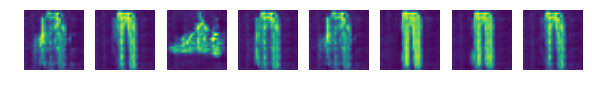

INFO:root:speed: 1239.749201012359 samples/s
INFO:root:discriminator loss = 0.005510, generator loss = 6.525948, binary training acc = 0.988275 at iter 600 epoch 18


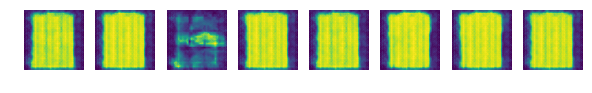

INFO:root:speed: 1235.367413434457 samples/s
INFO:root:discriminator loss = 0.012000, generator loss = 5.608612, binary training acc = 0.989568 at iter 700 epoch 18


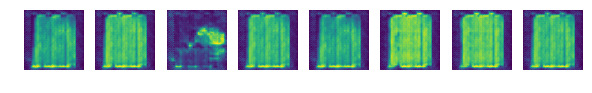

INFO:root:speed: 1194.2779043280182 samples/s
INFO:root:discriminator loss = 0.057042, generator loss = 5.690673, binary training acc = 0.990422 at iter 800 epoch 18


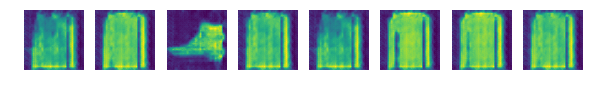

INFO:root:speed: 1259.10174674947 samples/s
INFO:root:discriminator loss = 0.006964, generator loss = 5.942371, binary training acc = 0.991225 at iter 900 epoch 18


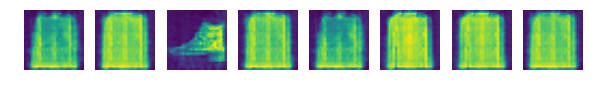

INFO:root:speed: 1198.4795785337976 samples/s
INFO:root:discriminator loss = 0.024384, generator loss = 5.285253, binary training acc = 0.991836 at iter 1000 epoch 18


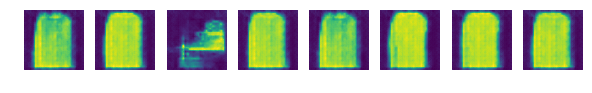

INFO:root:speed: 761.0526769412219 samples/s
INFO:root:discriminator loss = 0.002708, generator loss = 20.805576, binary training acc = 0.991286 at iter 1100 epoch 18


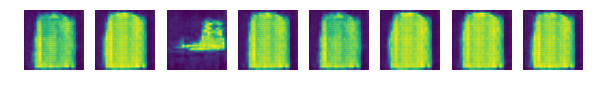

INFO:root:speed: 1198.8007145409074 samples/s
INFO:root:discriminator loss = 0.005126, generator loss = 6.705549, binary training acc = 0.991296 at iter 1200 epoch 18


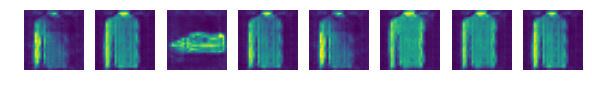

INFO:root:speed: 1250.8292219229659 samples/s
INFO:root:discriminator loss = 0.003755, generator loss = 7.145289, binary training acc = 0.991701 at iter 1300 epoch 18


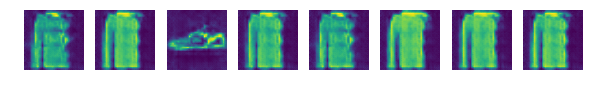

INFO:root:speed: 1106.9868531745378 samples/s
INFO:root:discriminator loss = 0.018658, generator loss = 7.480648, binary training acc = 0.992193 at iter 1400 epoch 18


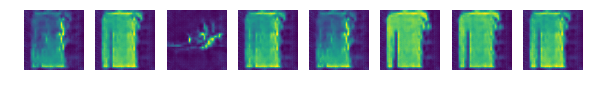

INFO:root:speed: 1240.2761883640128 samples/s
INFO:root:discriminator loss = 0.005007, generator loss = 8.042292, binary training acc = 0.992328 at iter 1500 epoch 18


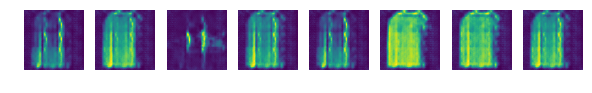

INFO:root:speed: 1270.9530699594711 samples/s
INFO:root:discriminator loss = 0.035159, generator loss = 5.466009, binary training acc = 0.992749 at iter 1600 epoch 18


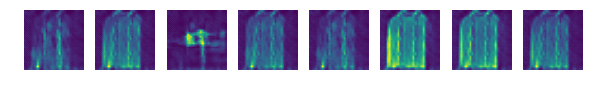

INFO:root:speed: 1264.296608892238 samples/s
INFO:root:discriminator loss = 0.003608, generator loss = 6.550320, binary training acc = 0.993065 at iter 1700 epoch 18


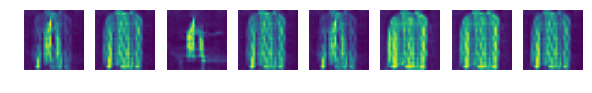

INFO:root:speed: 1243.989211533649 samples/s
INFO:root:discriminator loss = 0.001780, generator loss = 7.069434, binary training acc = 0.993372 at iter 1800 epoch 18


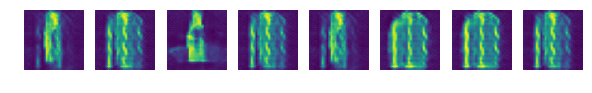

INFO:root:speed: 379.17932926329706 samples/s
INFO:root:discriminator loss = 0.003707, generator loss = 6.849743, binary training acc = 1.000000 at iter 0 epoch 19


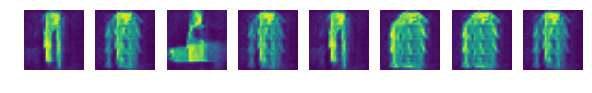

INFO:root:speed: 1230.9487508712718 samples/s
INFO:root:discriminator loss = 0.004152, generator loss = 6.697998, binary training acc = 0.998917 at iter 100 epoch 19


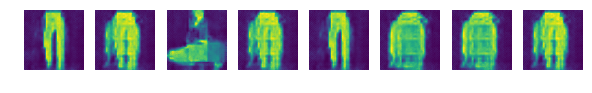

INFO:root:speed: 1103.2198586223903 samples/s
INFO:root:discriminator loss = 0.011863, generator loss = 8.058887, binary training acc = 0.991993 at iter 200 epoch 19


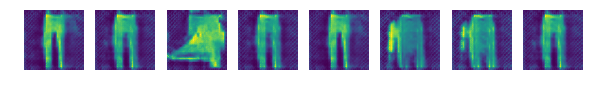

INFO:root:speed: 1195.320235826372 samples/s
INFO:root:discriminator loss = 0.005580, generator loss = 7.363549, binary training acc = 0.994290 at iter 300 epoch 19


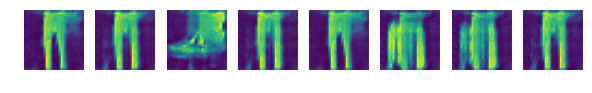

INFO:root:speed: 1239.5545581322324 samples/s
INFO:root:discriminator loss = 0.003367, generator loss = 8.511762, binary training acc = 0.988466 at iter 400 epoch 19


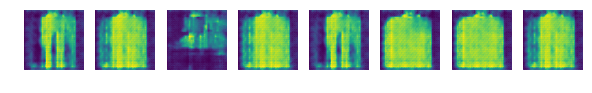

INFO:root:speed: 1248.8390494445168 samples/s
INFO:root:discriminator loss = 0.006459, generator loss = 6.681090, binary training acc = 0.990332 at iter 500 epoch 19


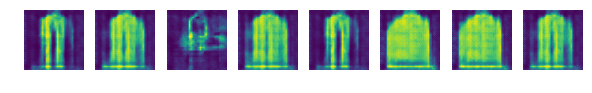

INFO:root:speed: 1282.857929346995 samples/s
INFO:root:discriminator loss = 0.026430, generator loss = 4.927837, binary training acc = 0.989341 at iter 600 epoch 19


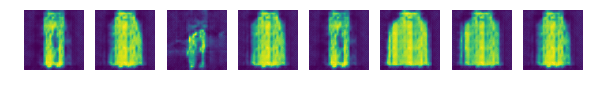

INFO:root:speed: 1247.411433404277 samples/s
INFO:root:discriminator loss = 0.011137, generator loss = 5.685860, binary training acc = 0.989234 at iter 700 epoch 19


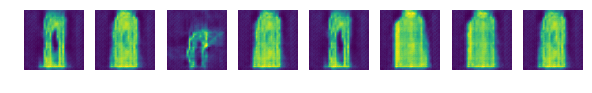

INFO:root:speed: 1272.1094893278234 samples/s
INFO:root:discriminator loss = 0.146304, generator loss = 4.120778, binary training acc = 0.989681 at iter 800 epoch 19


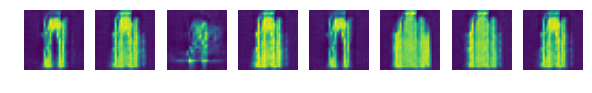

INFO:root:speed: 1113.0272332238696 samples/s
INFO:root:discriminator loss = 0.003014, generator loss = 6.807873, binary training acc = 0.990150 at iter 900 epoch 19


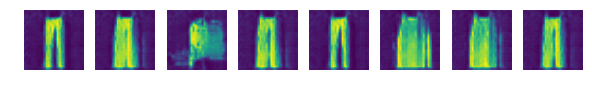

INFO:root:speed: 1192.2410460488913 samples/s
INFO:root:discriminator loss = 0.016705, generator loss = 7.258490, binary training acc = 0.990915 at iter 1000 epoch 19


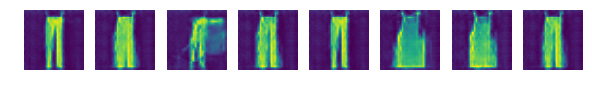

INFO:root:speed: 1249.9788407092833 samples/s
INFO:root:discriminator loss = 0.027330, generator loss = 5.442146, binary training acc = 0.991442 at iter 1100 epoch 19


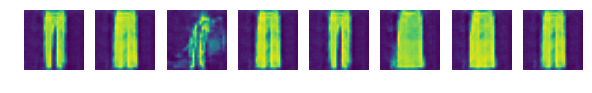

INFO:root:speed: 1189.451683800071 samples/s
INFO:root:discriminator loss = 0.003511, generator loss = 6.777359, binary training acc = 0.991557 at iter 1200 epoch 19


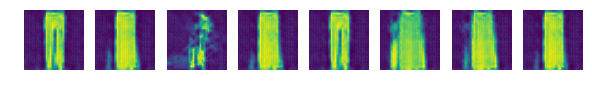

INFO:root:speed: 1111.6996985057815 samples/s
INFO:root:discriminator loss = 0.024160, generator loss = 5.972072, binary training acc = 0.991941 at iter 1300 epoch 19


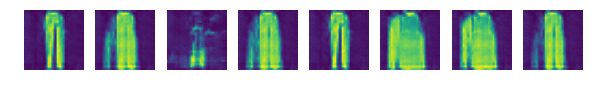

INFO:root:speed: 1254.2657907278826 samples/s
INFO:root:discriminator loss = 0.001369, generator loss = 7.184950, binary training acc = 0.992394 at iter 1400 epoch 19


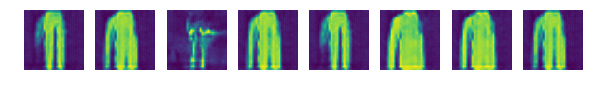

INFO:root:speed: 1263.5705557281517 samples/s
INFO:root:discriminator loss = 0.013379, generator loss = 7.090956, binary training acc = 0.992609 at iter 1500 epoch 19


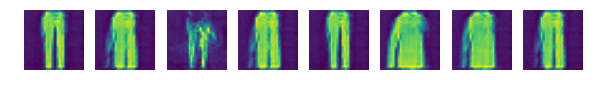

INFO:root:speed: 1281.0824575971901 samples/s
INFO:root:discriminator loss = 0.015261, generator loss = 5.516046, binary training acc = 0.992378 at iter 1600 epoch 19


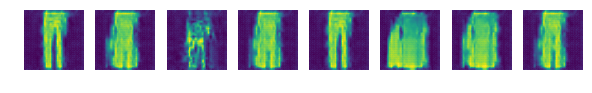

INFO:root:speed: 1242.5266432142196 samples/s
INFO:root:discriminator loss = 0.011685, generator loss = 5.903137, binary training acc = 0.992697 at iter 1700 epoch 19


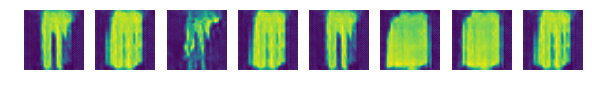

INFO:root:speed: 1274.9007665491988 samples/s
INFO:root:discriminator loss = 0.020318, generator loss = 6.447943, binary training acc = 0.992660 at iter 1800 epoch 19


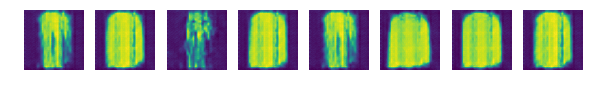

In [12]:
from datetime import datetime
import time
import logging

real_label = nd.ones((batch_size,), ctx=ctx)
fake_label = nd.zeros((batch_size,),ctx=ctx)

def facc(label, pred):
    pred = pred.ravel()
    label = label.ravel()
    return ((pred > 0.5) == label).mean()
metric = mx.metric.CustomMetric(facc)

stamp =  datetime.now().strftime('%Y_%m_%d-%H_%M')
logging.basicConfig(level=logging.DEBUG)

for epoch in range(epochs):
    tic = time.time()
    btic = time.time()
    iter = 0
    for (data, label) in train_data:
        # 원래 데이터 형태는 1 X 28 X 28임 -> DCGAN 네트워크 활용을 위해서 이미지 데이터의 크기를 조절
        X = np.zeros((batch_size, 28, 28))
        for idx in range(data.shape[0]):
            X[idx] = data.asnumpy()[idx,0,:,:]
        X = np.asarray([cv2.resize(x, (64,64)) for x in X])
        X = X.reshape((batch_size,1,64,64))
        data = nd.array(X,ctx=ctx)
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        latent_z = mx.nd.random_normal(0, 1, shape=(batch_size, latent_z_size, 1, 1), ctx=ctx)
    
        #Gradient를 산출 및 이를 Back prop.에 적용
        with autograd.record():
            # train with real image
            output = netD(data).reshape((-1, 1))
            errD_real = loss(output, real_label)
            metric.update([real_label,], [output,])

            # train with fake image
            fake = netG(latent_z)
            output = netD(fake.detach()).reshape((-1, 1))
            errD_fake = loss(output, fake_label)
            errD = errD_real + errD_fake
            errD.backward()
            metric.update([fake_label,], [output,])

        trainerD.step(data.shape[0])

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        with autograd.record():
            fake = netG(latent_z)
            output = netD(fake).reshape((-1, 1))
            errG = loss(output, real_label)
            errG.backward()

        trainerG.step(data.shape[0])

        # Print log infomation every ten batches
        if iter % 100 == 0:
            name, acc = metric.get()
            logging.info('speed: {} samples/s'.format(batch_size / (time.time() - btic)))
            logging.info('discriminator loss = %f, generator loss = %f, binary training acc = %f at iter %d epoch %d'
                     %(nd.mean(errD).asscalar(),
                       nd.mean(errG).asscalar(), acc, iter, epoch))
            gen_img = netG(fixed_z)
            #print(gen_img.shape)
            plt.figure(figsize=(10,10))
            for i in range(8):
                plt.subplot(1,8,i+1)
                # 이미 64 * 64의 크기로 되어 있음
                plt.imshow(gen_img[i][0].asnumpy())
                plt.axis('off')
                plt.Annotation(i, (0, 0))
            plt.show()
        iter = iter + 1
        btic = time.time()

    name, acc = metric.get()
    metric.reset()
    # logging.info('\nbinary training acc at epoch %d: %s=%f' % (epoch, name, acc))
    # logging.info('time: %f' % (time.time() - tic))

    # Visualize one generated image for each epoch
